### Final annotation of Epithelial cells from stomach


Preprocessing:
- epithelial cells from main object subsetted, then subsetted cells from stomach
- performed scvi batch correction to prepare objects

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/post_scvi20221124/Stomach_epi.hvg5000_noRPL.scvi_output.with_annotv2.22021124.h5ad')

In [3]:
adata

AnnData object with n_obs × n_vars = 53953 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

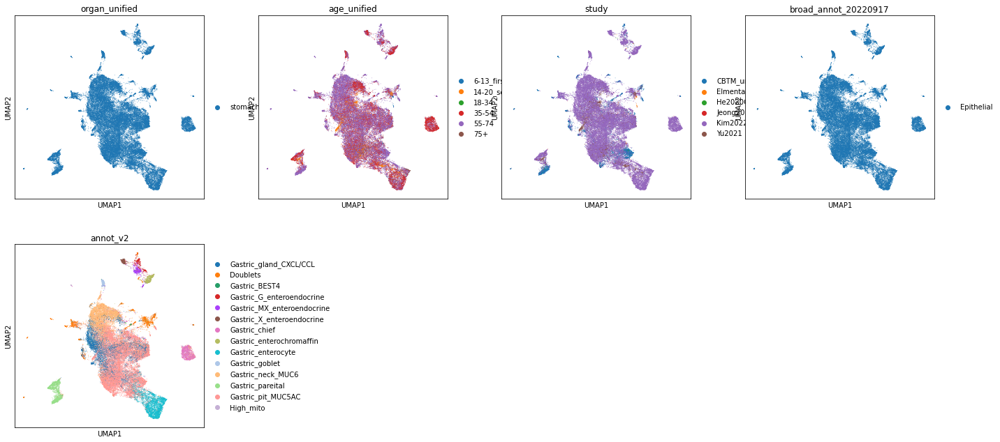

In [5]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata, color=['organ_unified', 'age_unified','study','broad_annot_20220917','annot_v2'])

In [6]:
adata.X.max()

20625.0

In [7]:
#save raw counts in layers
adata.layers['counts'] = adata.X
#normalise and transform
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)

In [8]:
adata.X.max()

8.9637165

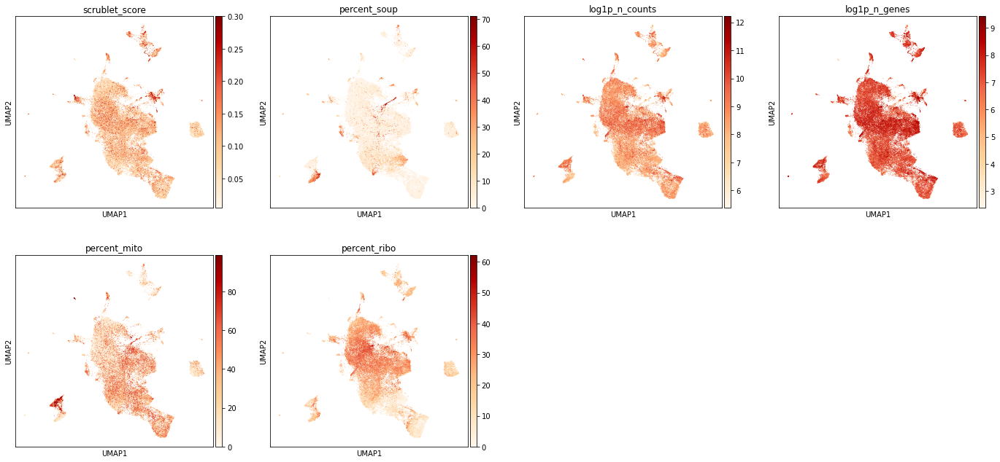

In [9]:
#plot some basic QC
sc.pl.umap(adata, color = ['scrublet_score','percent_soup','log1p_n_counts','log1p_n_genes','percent_mito','percent_ribo'],cmap='OrRd')

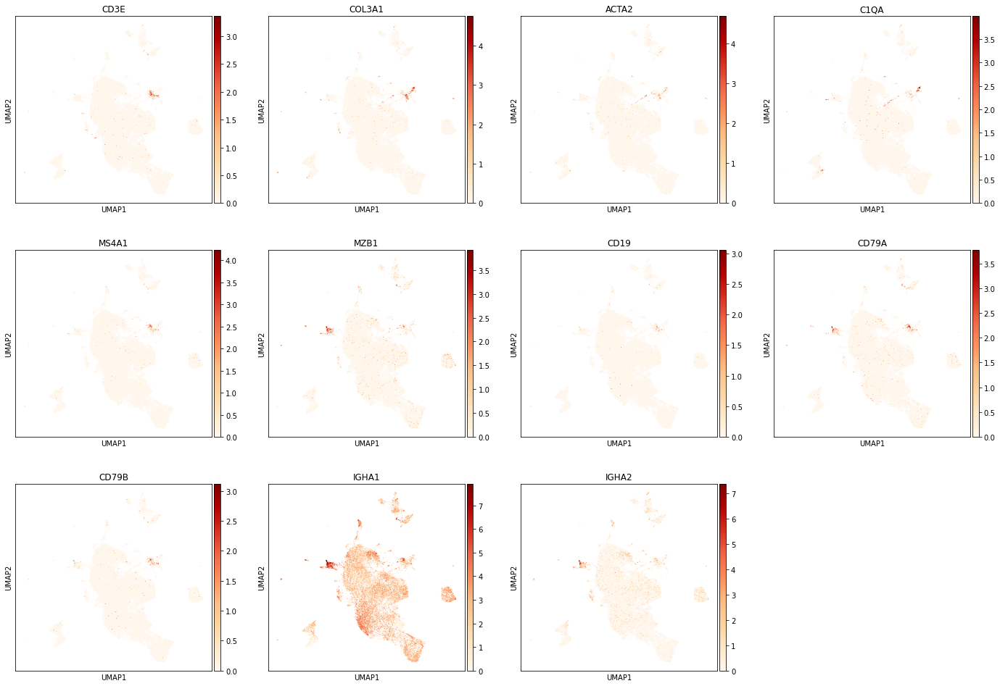

In [10]:
#plot doublet genes
sc.pl.umap(adata, color = ['CD3E','COL3A1','ACTA2','C1QA','MS4A1','MZB1','CD19','CD79A','CD79B','IGHA1','IGHA2'],cmap='OrRd')

In [11]:
#score cell cycle genes
cell_cycle_genes = ['MCM5',
'PCNA',
 'TYMS',
 'FEN1',
 'MCM2',
 'MCM4',
 'RRM1',
 'UNG',
 'GINS2',
 'MCM6',
 'CDCA7',
 'DTL',
 'PRIM1',
 'UHRF1',
 'MLF1IP',
 'HELLS',
 'RFC2',
 'RPA2',
 'NASP',
 'RAD51AP1',
 'GMNN',
 'WDR76',
 'SLBP',
 'CCNE2',
 'UBR7',
 'POLD3',
 'MSH2',
 'ATAD2',
 'RAD51',
 'RRM2',
 'CDC45',
 'CDC6',
 'EXO1',
 'TIPIN',
 'DSCC1',
 'BLM',
 'CASP8AP2',
 'USP1',
 'CLSPN',
 'POLA1',
 'CHAF1B',
 'BRIP1',
 'E2F8',
 'HMGB2',
 'CDK1',
 'NUSAP1',
 'UBE2C',
 'BIRC5',
 'TPX2',
 'TOP2A',
 'NDC80',
 'CKS2',
 'NUF2',
 'CKS1B',
 'MKI67',
 'TMPO',
 'CENPF',
 'TACC3',
 'FAM64A',
 'SMC4',
 'CCNB2',
 'CKAP2L',
 'CKAP2',
 'AURKB',
 'BUB1',
 'KIF11',
 'ANP32E',
 'TUBB4B',
 'GTSE1',
 'KIF20B',
 'HJURP',
 'CDCA3',
 'HN1',
 'CDC20',
 'TTK',
 'CDC25C',
 'KIF2C',
 'RANGAP1',
 'NCAPD2',
 'DLGAP5',
 'CDCA2',
 'CDCA8',
 'ECT2',
 'KIF23',
 'HMMR',
 'AURKA',
 'PSRC1',
 'ANLN',
 'LBR',
 'CKAP5',
 'CENPE',
 'CTCF',
 'NEK2',
 'G2E3',
 'GAS2L3',
 'CBX5',
 'CENPA']

In [12]:
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)
adata = adata[adata.obs.G2M_score.sort_values(ascending=True).index].copy()

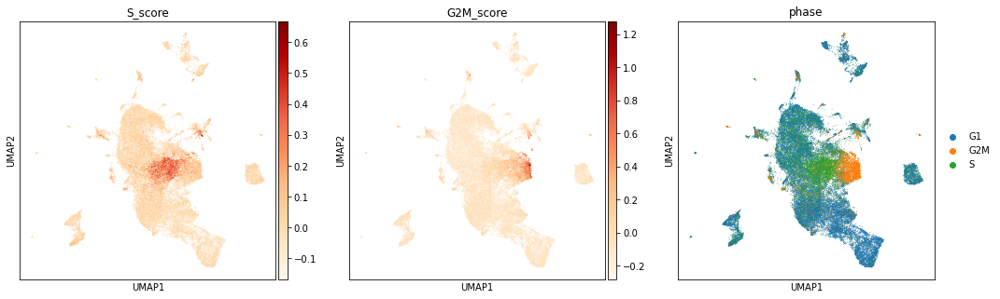

In [13]:
sc.pl.umap(adata,color=['S_score', 'G2M_score', 'phase'],cmap='OrRd')

In [14]:
sc.tl.leiden(adata, resolution = 0.5, neighbors_key="neighbors_scvi")

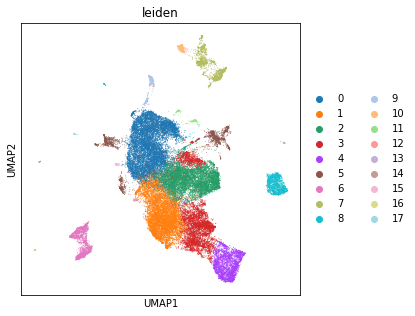

In [15]:
sc.pl.umap(adata,color='leiden')

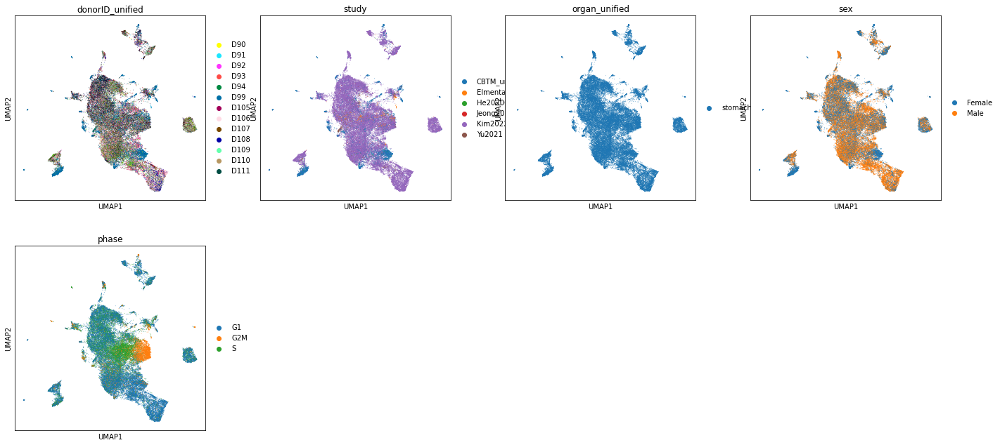

In [17]:
sc.pl.umap(adata,color=['donorID_unified','study','organ_unified','sex','phase'])

In [5]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import * 

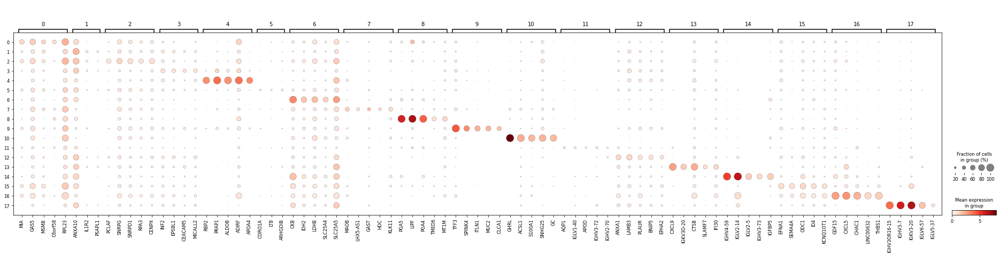

In [19]:
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='leiden', mks=mks)

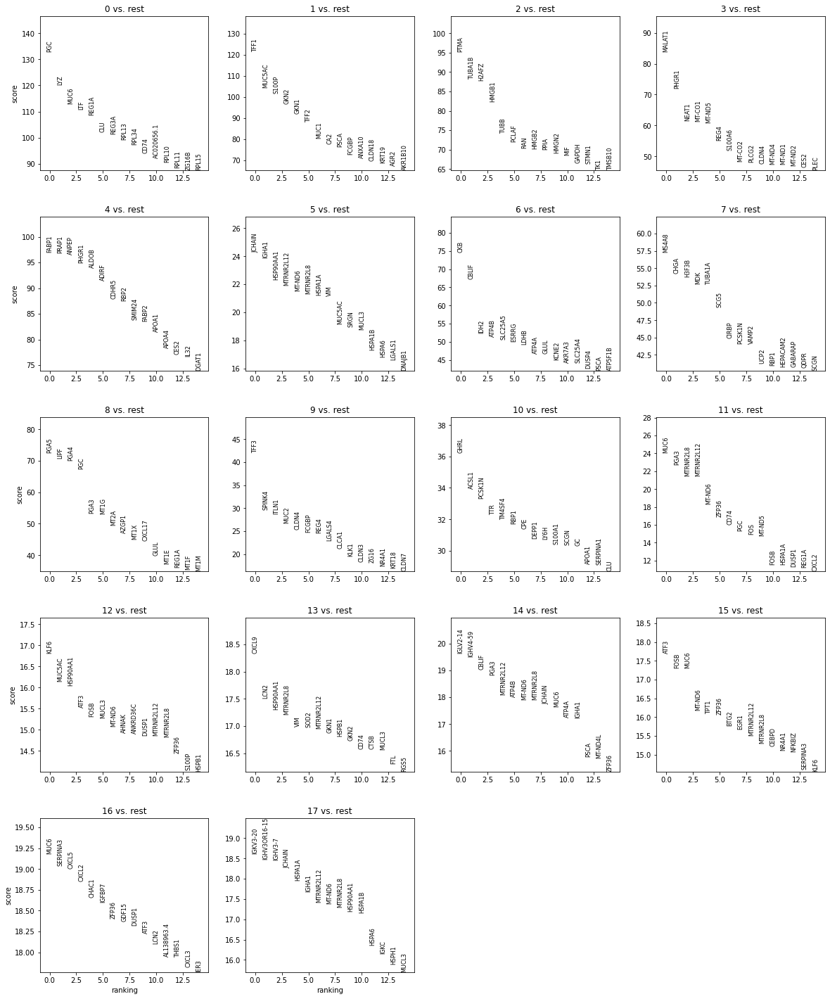

In [20]:
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=15, sharey=False)

         Falling back to preprocessing with `sc.pp.pca` and default params.


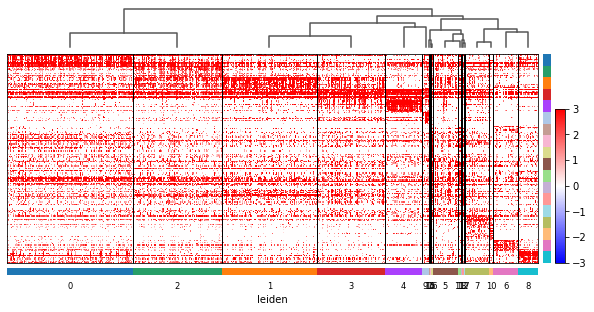

In [21]:
sc.tl.rank_genes_groups(adata,groupby='leiden',method='wilcoxon')
sc.tl.dendrogram(adata, groupby='leiden')
sc.pl.rank_genes_groups_heatmap(adata,groupby='leiden', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=False,
                                vmin=-3, vmax=3, cmap='bwr')

In [22]:
pd.crosstab(adata.obs.annot_v2,adata.obs.leiden)

leiden,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
annot_v2,,,,,,,,,,,,,,,,,,
Gastric_gland_CXCL/CCL,2589,1709,1921,377,23,300,9,3,5,26,0,10,175,3,0,12,0,0
Doublets,170,226,205,85,15,1886,15,224,26,2,1,226,1,126,129,111,123,118
Gastric_BEST4,2,0,0,50,0,2,0,1,0,4,2,0,0,0,0,0,0,0
Gastric_G_enteroendocrine,4,0,2,1,0,5,0,537,0,3,15,0,0,0,0,0,0,0
Gastric_MX_enteroendocrine,0,0,8,23,0,5,0,685,2,12,10,0,0,0,0,0,0,0
Gastric_X_enteroendocrine,0,0,0,0,2,0,0,15,0,0,422,0,0,0,0,0,0,0
Gastric_chief,120,0,10,10,1,9,7,2,1768,3,0,6,0,0,1,0,0,0
Gastric_enterochromaffin,3,1,0,1,0,4,0,895,2,2,0,0,0,0,0,0,0,0
Gastric_enterocyte,9,32,48,867,3614,19,1,1,0,1,0,1,0,0,0,0,0,0


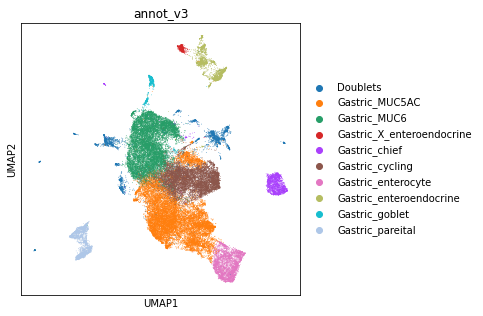

In [88]:
new_cluster_names = [
    'Gastric_MUC6','Gastric_MUC5AC', #0,1
    'Gastric_cycling','Gastric_MUC5AC', #2,3
    'Gastric_enterocyte','Doublets', #4,5
    'Gastric_pareital','Gastric_enteroendocrine', #6,7 
    'Gastric_chief','Gastric_goblet', #8,9
    'Gastric_X_enteroendocrine','Doublets', #10 ,11
    'Gastric_MUC5AC','Doublets',#12,13
     'Doublets','Doublets',#14,15
     'Doublets','Doublets'#16,17

]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

adata.obs['annot_v3'] = [conv[x] for x in adata.obs['leiden']]
sc.pl.umap(adata,color='annot_v3')

In [57]:
muc5ac = adata[adata.obs.annot_v3.isin(['Gatric_cycling','Gastric_MUC5AC'])].copy()

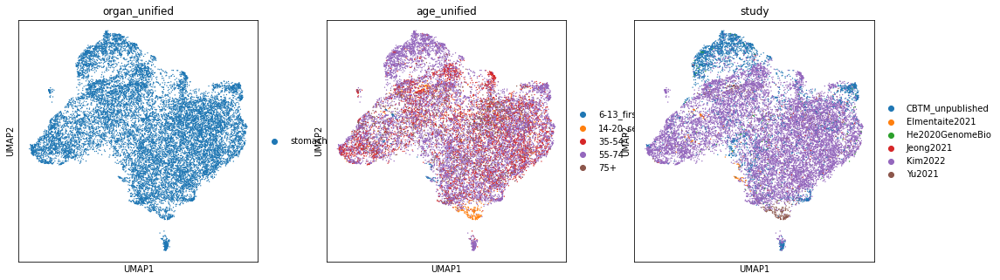

In [58]:
sc.pp.neighbors(
            muc5ac,
            use_rep="X_scvi",
            n_pcs=muc5ac.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(muc5ac, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(muc5ac, color=['organ_unified', 'age_unified','study'])

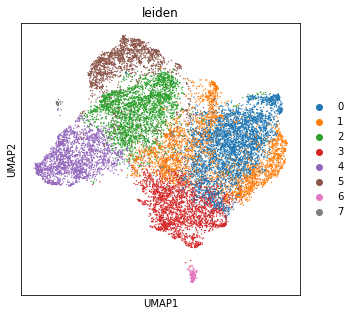

In [59]:
sc.tl.leiden(muc5ac, resolution = 0.5, neighbors_key="neighbors_scvi")
sc.pl.umap(muc5ac, color=['leiden'])

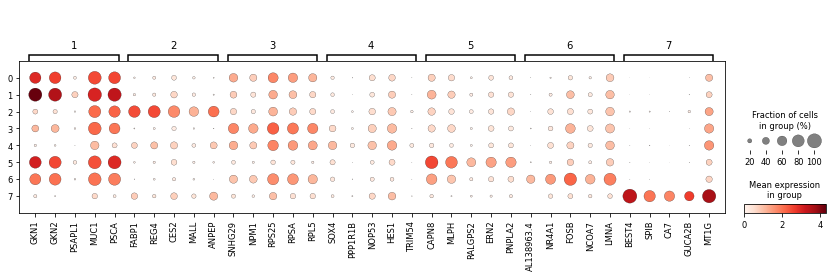

In [60]:
muc5ac.raw = muc5ac.copy()
mkst = calc_marker_stats(muc5ac, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(muc5ac, groupby='leiden', mks=mks)

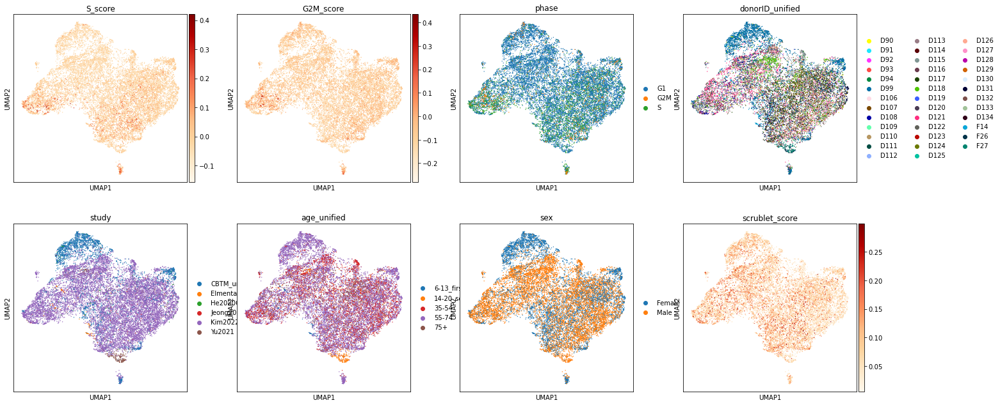

In [61]:
sc.pl.umap(muc5ac,color=['S_score','G2M_score','phase','donorID_unified','study','age_unified','sex','scrublet_score'],cmap='OrRd')

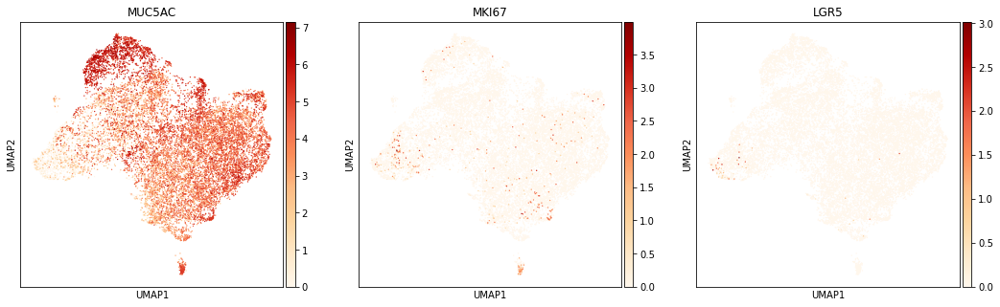

In [71]:
sc.pl.umap(muc5ac,color=['MUC5AC','MKI67','LGR5'],cmap='OrRd')

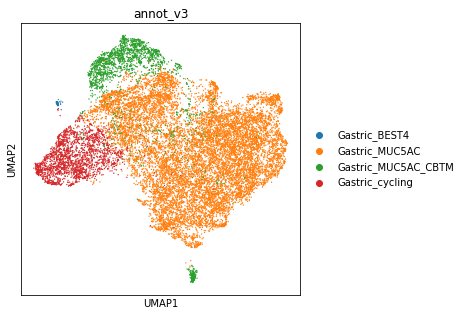

In [89]:
sc.pl.umap(muc5ac,color=['annot_v3'])

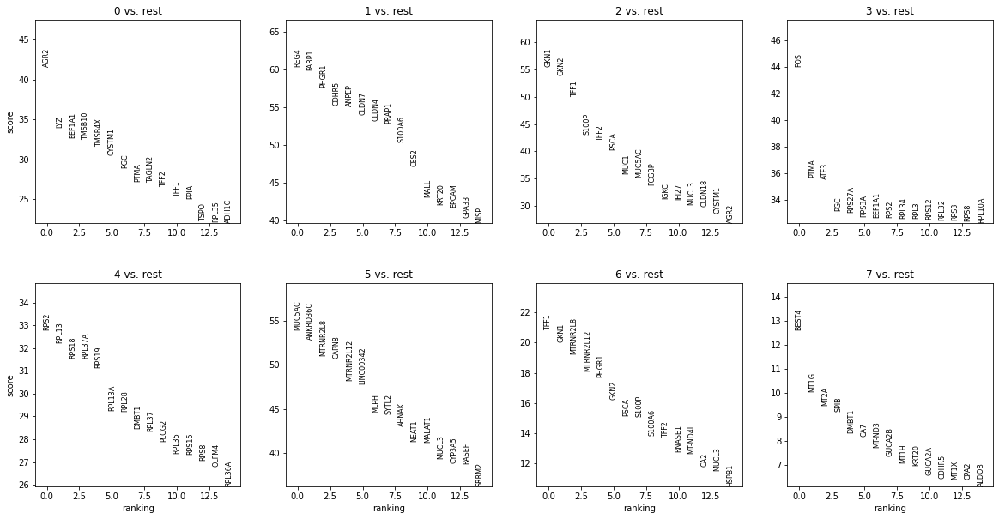

In [34]:
sc.tl.rank_genes_groups(muc5ac, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(muc5ac, n_genes=15, sharey=False)

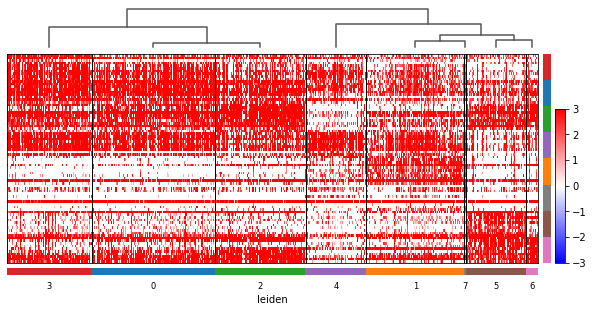

In [35]:
sc.tl.rank_genes_groups(muc5ac,groupby='leiden',method='wilcoxon')
sc.tl.dendrogram(muc5ac, groupby='leiden')
sc.pl.rank_genes_groups_heatmap(muc5ac,groupby='leiden', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=False,
                                vmin=-3, vmax=3, cmap='bwr')

In [119]:
new_cluster_names = [
    'Gastric_MUC5AC','Gastric_MUC5AC', #0,1
    'Gastric_MUC5AC','Gastric_MUC5AC',#2,3
    'Gastric_cycling','Gastric_MUC5AC_CBTM',#4,5
    'Gastric_MUC5AC_CBTM','Gastric_BEST4',#6,7
    
]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

muc5ac.obs['annot_v3'] = [conv[x] for x in muc5ac.obs['leiden']]

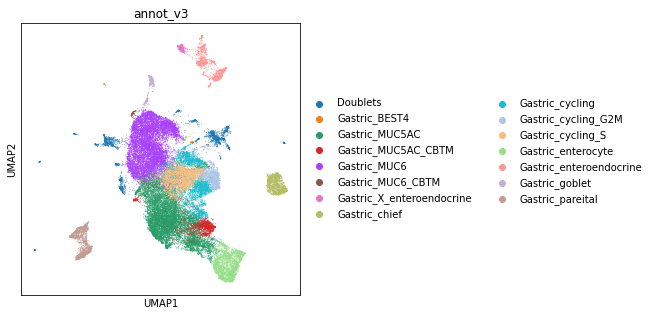

In [120]:
ON = {O:N for O,N in zip(muc5ac.obs_names,muc5ac.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

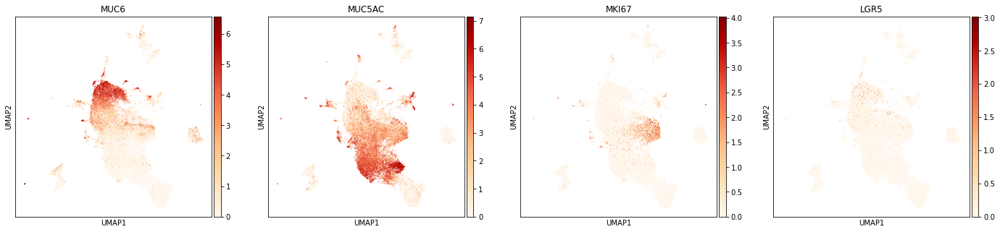

In [73]:
sc.pl.umap(adata,color=['MUC6','MUC5AC','MKI67','LGR5'],cmap='OrRd')

In [42]:
muc6 = adata[adata.obs.annot_v3.isin(['Gastric_MUC6'])].copy()

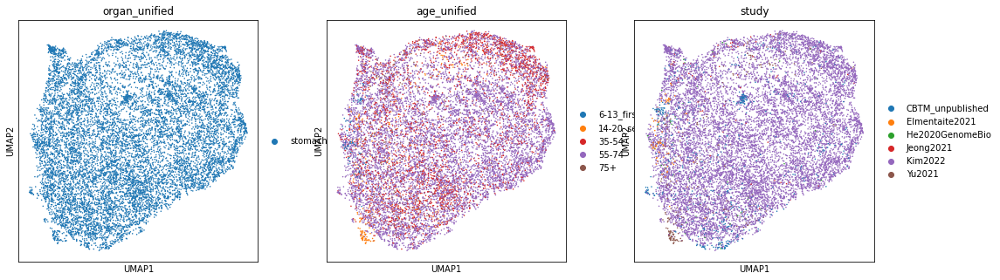

In [43]:
sc.pp.neighbors(
            muc6,
            use_rep="X_scvi",
            n_pcs=muc6.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(muc6, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(muc6, color=['organ_unified', 'age_unified','study'])

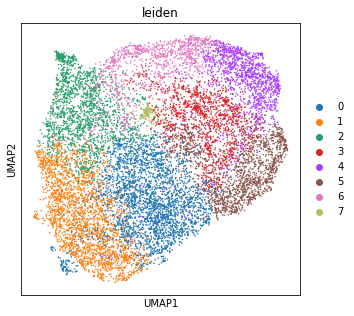

In [109]:
sc.tl.leiden(muc6, resolution = 0.5, neighbors_key="neighbors_scvi")
sc.pl.umap(muc6, color=['leiden'])

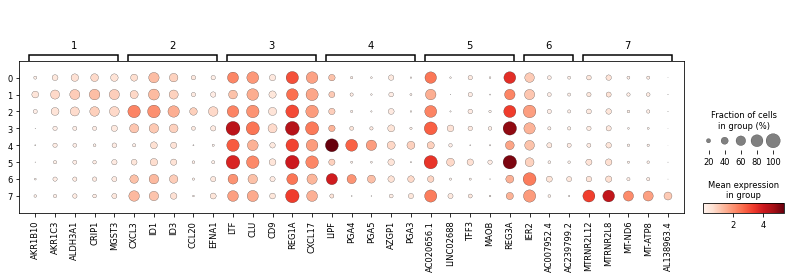

In [75]:
muc6.raw = muc6.copy()
mkst = calc_marker_stats(muc6, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(muc6, groupby='leiden', mks=mks)

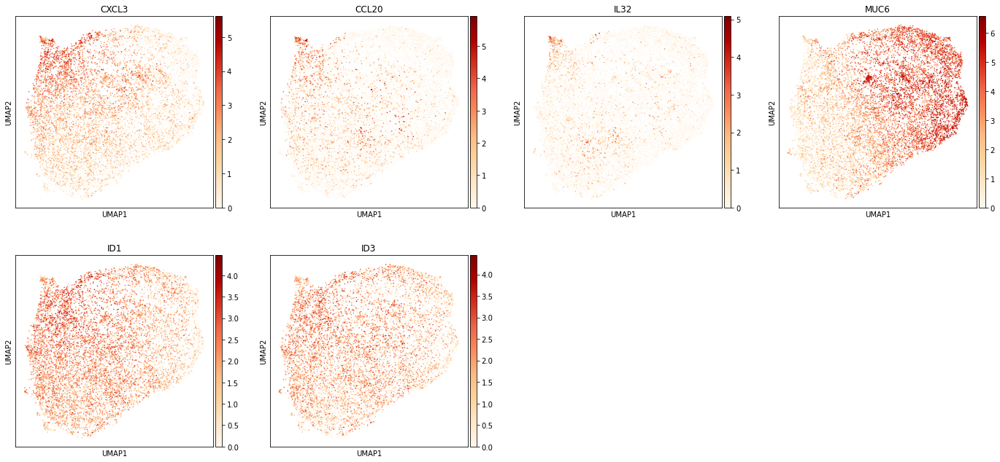

In [76]:
sc.pl.umap(muc6,color=['CXCL3','CCL20','IL32','MUC6','ID1','ID3'],cmap='OrRd')

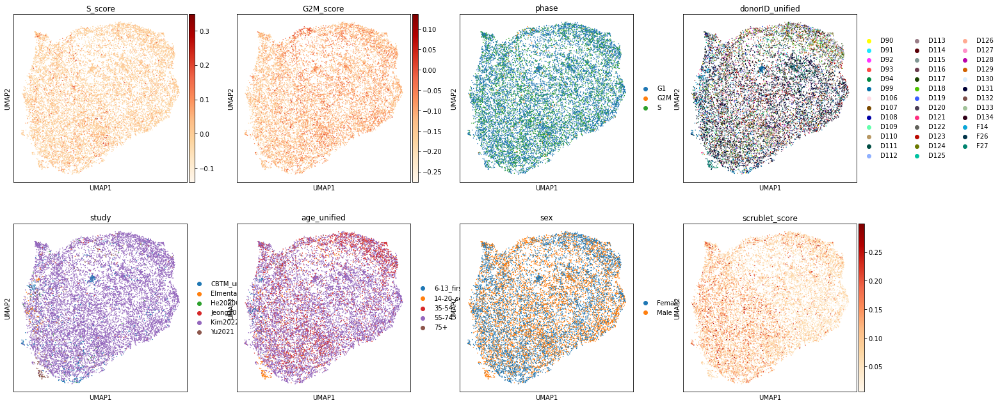

In [48]:
sc.pl.umap(muc6,color=['S_score','G2M_score','phase','donorID_unified','study','age_unified','sex','scrublet_score'],cmap='OrRd')

In [92]:
new_cluster_names = [
    'Gastric_MUC6','Gastric_MUC6', #0,1
    'Gastric_MUC6','Gastric_MUC6',#2,3
    'Gastric_MUC6','Gastric_MUC6',#4,5
    'Gastric_MUC6','Gastric_MUC6_CBTM',#6,7
    
]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

muc6.obs['annot_v3'] = [conv[x] for x in muc6.obs['leiden']]

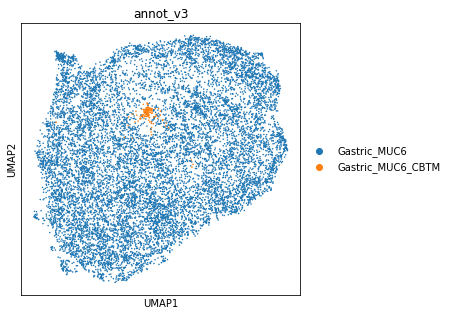

In [93]:
sc.pl.umap(muc6,color='annot_v3')

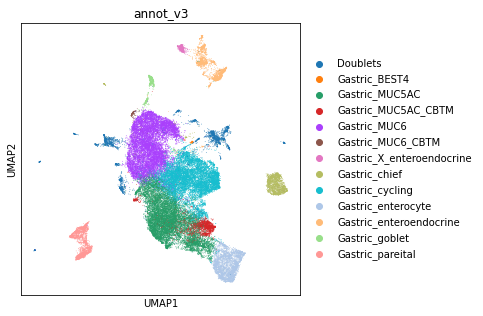

In [94]:
ON = {O:N for O,N in zip(muc6.obs_names,muc6.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [95]:
cycling = adata[adata.obs.annot_v3.isin(['Gastric_cycling'])].copy()

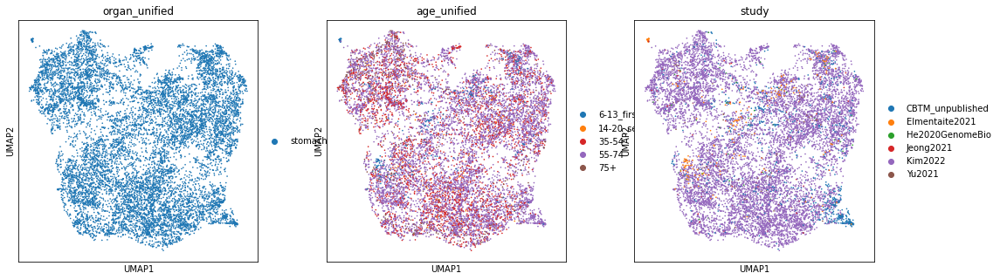

In [125]:
sc.pp.neighbors(
            cycling,
            use_rep="X_scvi",
            n_pcs=cycling.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(cycling, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(cycling, color=['organ_unified', 'age_unified','study'])

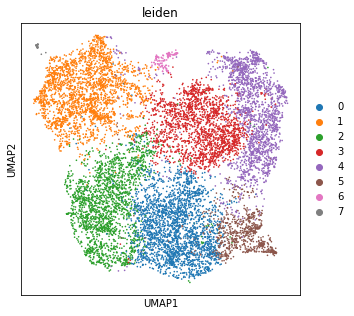

In [126]:
sc.tl.leiden(cycling, resolution = 0.5, neighbors_key="neighbors_scvi")
sc.pl.umap(cycling, color=['leiden'])

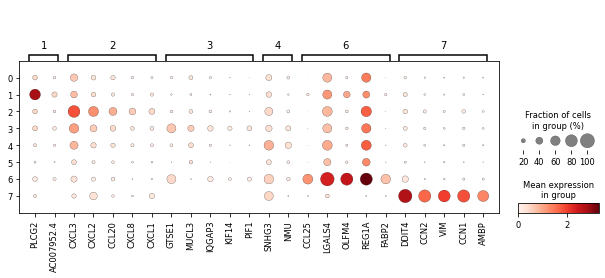

In [127]:
cycling.raw = cycling.copy()
mkst = calc_marker_stats(cycling, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(cycling, groupby='leiden', mks=mks)

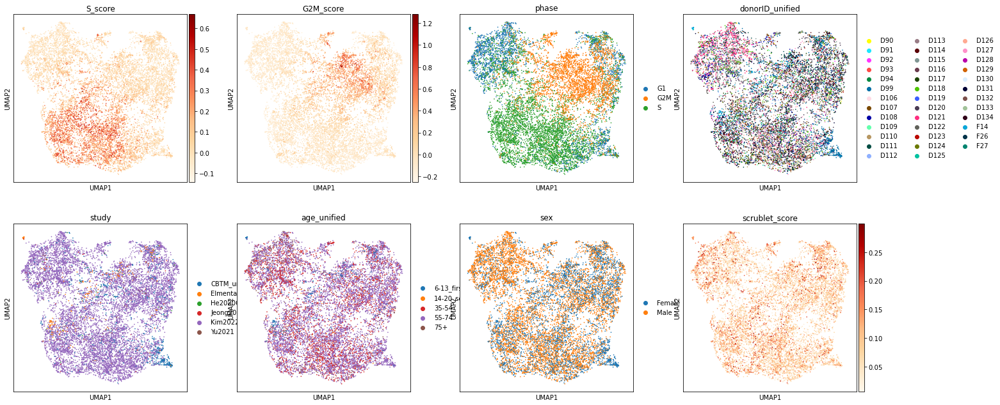

In [128]:
sc.pl.umap(cycling,color=['S_score','G2M_score','phase','donorID_unified','study','age_unified','sex','scrublet_score'],cmap='OrRd')

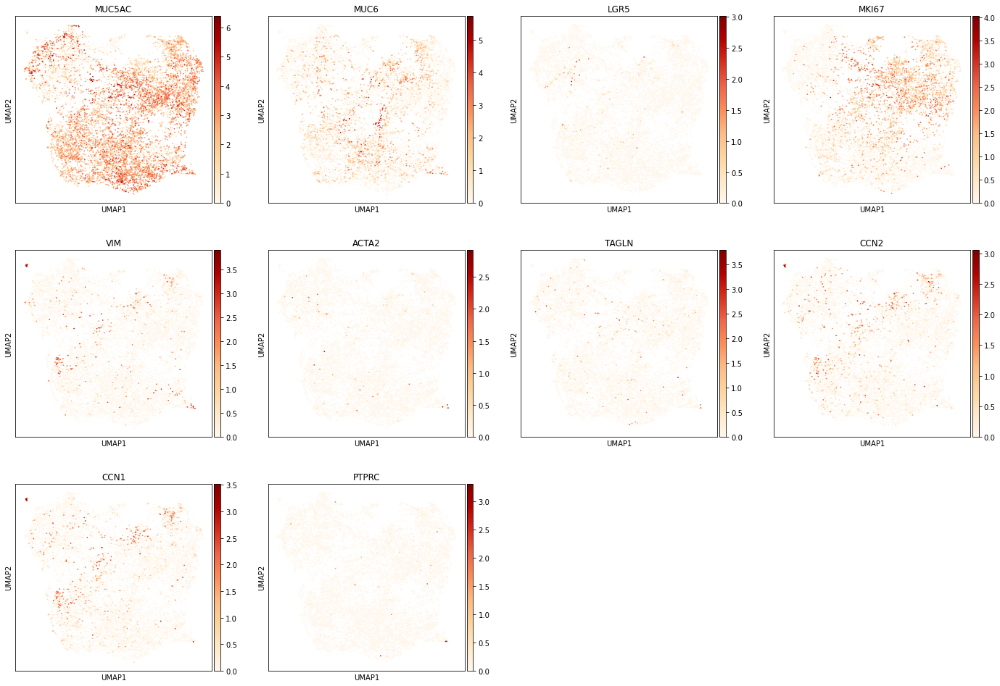

In [116]:
sc.pl.umap(cycling,color=['MUC5AC','MUC6','LGR5','MKI67','VIM','ACTA2','TAGLN','CCN2','CCN1','PTPRC'],cmap='OrRd')

In [121]:
new_cluster_names = [
    'Gastric_cycling','Gastric_cycling', #0,1
    'Gastric_cycling','Gastric_cycling',#2,3
    'Gastric_cycling','Gastric_cycling',#4,5
    'Gastric_cycling','Gastric_fetal',#6,7
    
]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

cycling.obs['annot_v3'] = [conv[x] for x in cycling.obs['leiden']]

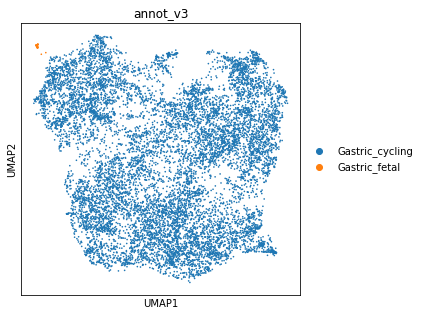

In [122]:
sc.pl.umap(cycling,color='annot_v3')

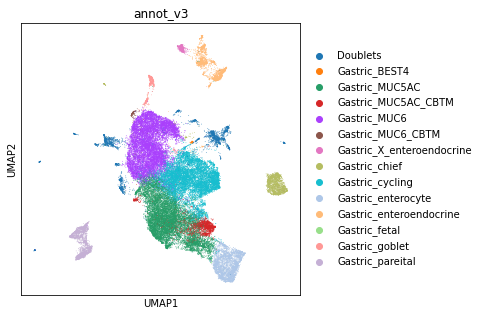

In [123]:
ON = {O:N for O,N in zip(cycling.obs_names,cycling.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [124]:
eec = adata[adata.obs.annot_v3.isin(['Gastric_enteroendocrine','Gastric_X_enteroendocrine'])].copy()

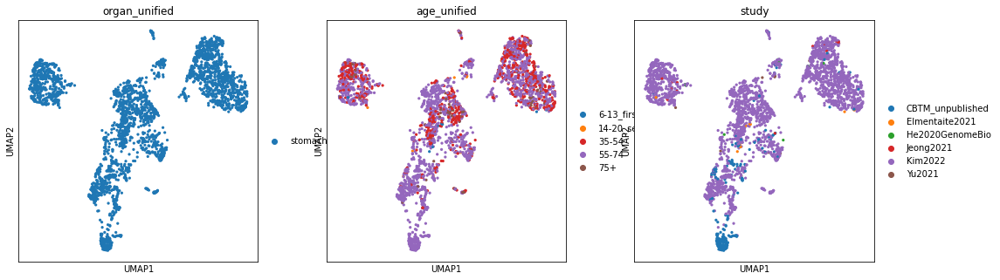

In [130]:
sc.pp.neighbors(
            eec,
            use_rep="X_scvi",
            n_pcs=eec.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(eec, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(eec, color=['organ_unified', 'age_unified','study'])

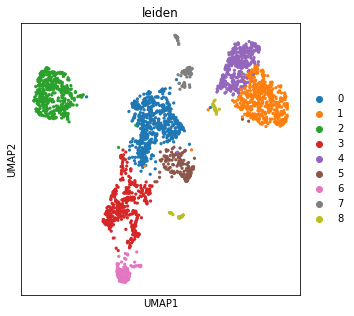

In [131]:
sc.tl.leiden(eec, resolution = 0.5, neighbors_key="neighbors_scvi")
sc.pl.umap(eec, color=['leiden'])

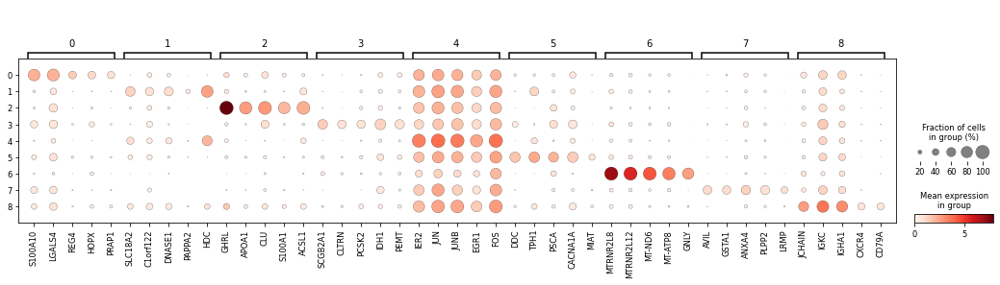

In [134]:
eec.raw = eec.copy()
mkst = calc_marker_stats(eec, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(eec, groupby='leiden', mks=mks)

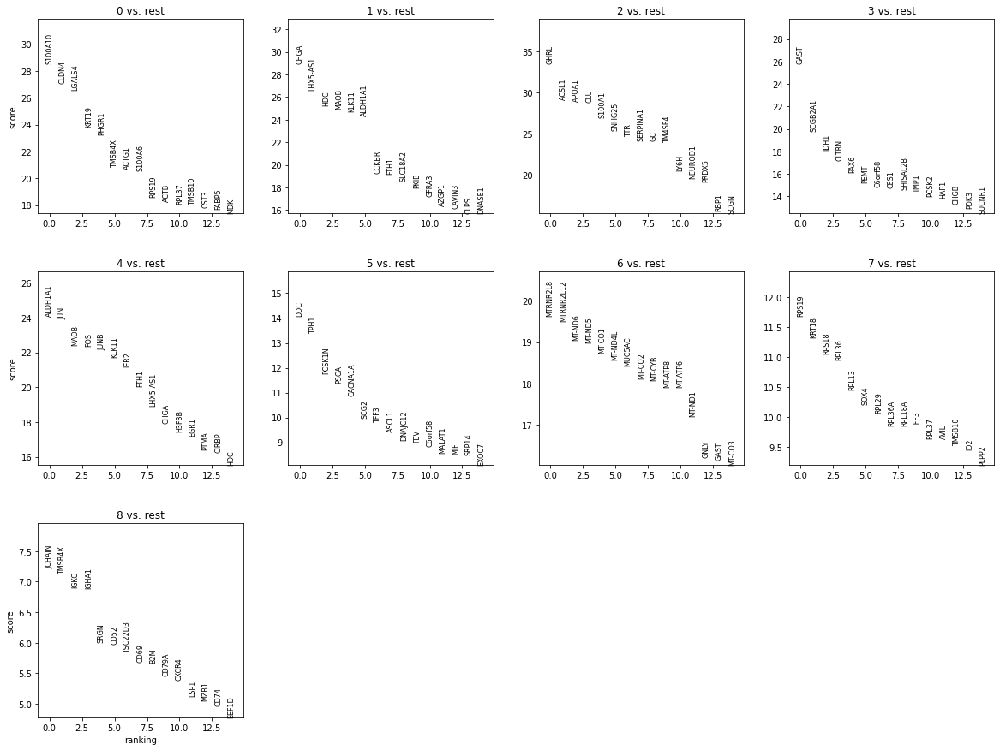

In [139]:
sc.tl.rank_genes_groups(eec, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(eec, n_genes=15, sharey=False)

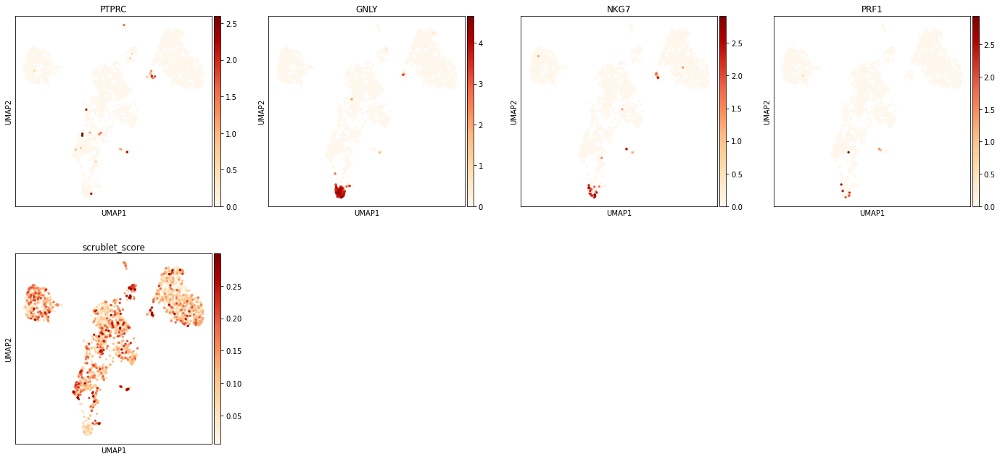

In [138]:
sc.pl.umap(eec, color=['PTPRC','GNLY','NKG7','PRF1','scrublet_score'],cmap='OrRd')

In [132]:
pd.crosstab(eec.obs.annot_v2,eec.obs.leiden)

leiden,0,1,2,3,4,5,6,7,8
annot_v2,,,,,,,,,
Gastric_gland_CXCL/CCL,0,0,0,1,0,0,0,2,0
Doublets,11,3,1,18,1,2,128,20,41
Gastric_BEST4,0,0,2,1,0,0,0,0,0
Gastric_G_enteroendocrine,37,12,16,338,0,131,17,0,1
Gastric_MX_enteroendocrine,518,6,17,49,13,18,1,70,3
Gastric_X_enteroendocrine,4,0,426,4,0,3,0,0,0
Gastric_chief,1,1,0,0,0,0,0,0,0
Gastric_enterochromaffin,20,476,0,1,374,10,0,1,13
Gastric_enterocyte,1,0,0,0,0,0,0,0,0


In [ ]:
Chromogranin A (CHGA) EC cells
Motilin (MLN) M cells
Gastrin (GAST) G cells
Gip (GIP) K cells
Cholestocystokin (CCK) I cells
Tryptophan hydroxylase 1
(TPH1, serotonin) EC cells

Chromogranin A (CHGA) EC cells
Glucagon (GCG, GLP-1) L cells
Motilin (MLN) M cells
Ghrelin (GHRL) X cells
Somatostatin (SST) D cells
Neurotensin (NTS) N cells
Tryptophan hydroxylase 1
(TPH1, serotonin) EC cells

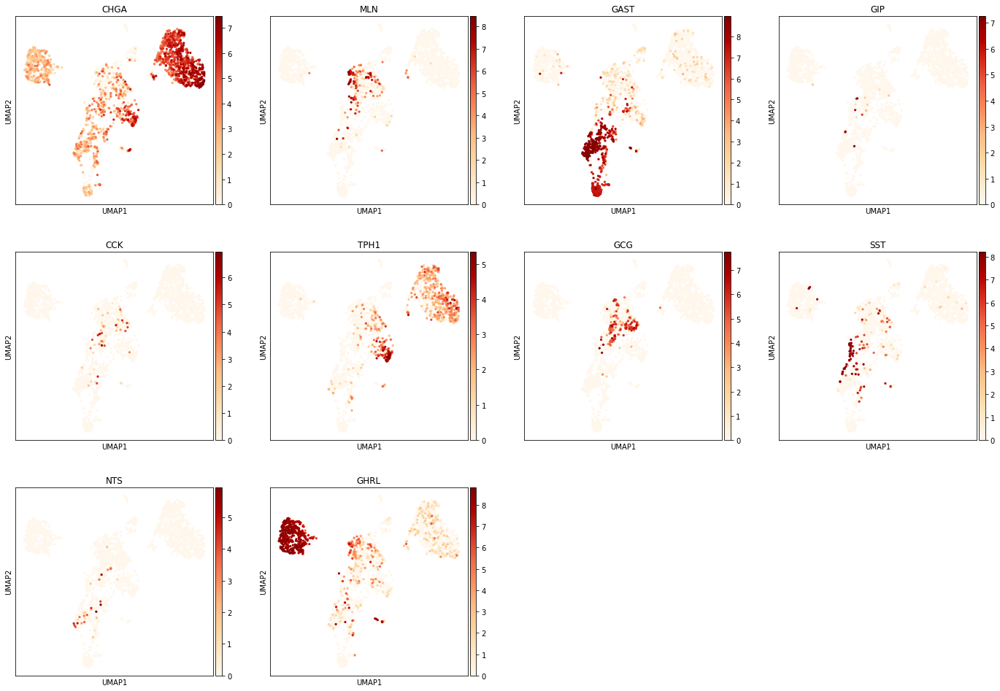

In [144]:
sc.pl.umap(eec,color=['CHGA','MLN','GAST','GIP','CCK','TPH1','GCG','SST','NTS','GHRL'],cmap='OrRd')

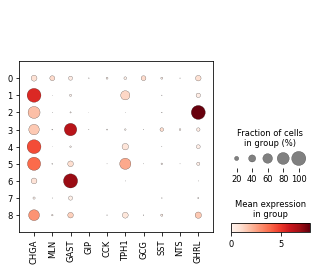

In [255]:
sc.pl.dotplot(eec,var_names=['CHGA','MLN','GAST','GIP','CCK','TPH1','GCG','SST','NTS','GHRL'],groupby='leiden')

In [164]:
new_cluster_names = [
    'Gastric_MX_enteroendocrine','Gastric_enterochromaffin', #0,1
    'Gastric_X_enteroendocrine','Gastric_G_enteroendocrine',#2,3
    'Gastric_enterochromaffin','Gastric_enteroendocrine',#4,5
    'Doublets','Doublets',#6,7
    'Doublets'
    
]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

eec.obs['annot_v3'] = [conv[x] for x in eec.obs['leiden']]

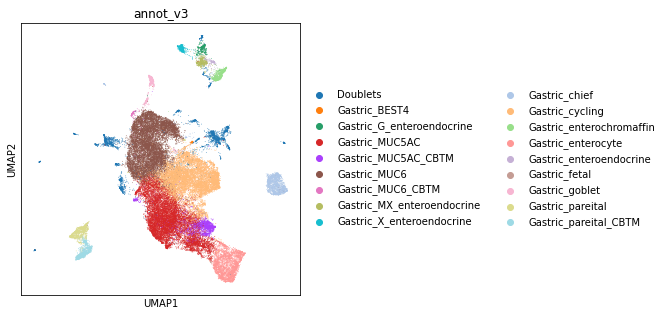

In [165]:
ON = {O:N for O,N in zip(eec.obs_names,eec.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [145]:
par = adata[adata.obs.annot_v3.isin(['Gastric_pareital'])].copy()

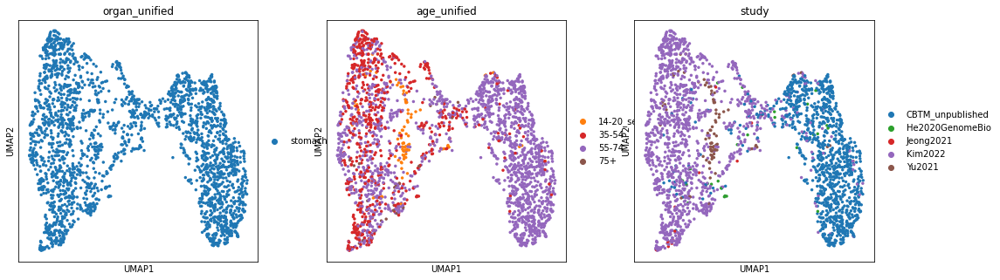

In [146]:
sc.pp.neighbors(
            par,
            use_rep="X_scvi",
            n_pcs=par.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(par, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(par, color=['organ_unified', 'age_unified','study'])

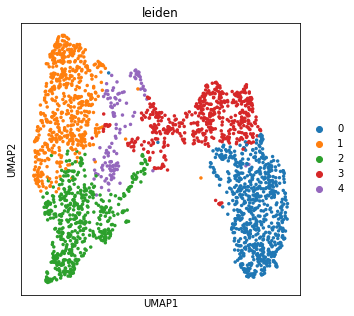

In [151]:
sc.tl.leiden(par, resolution = 0.5, neighbors_key="neighbors_scvi")
sc.pl.umap(par, color=['leiden'])

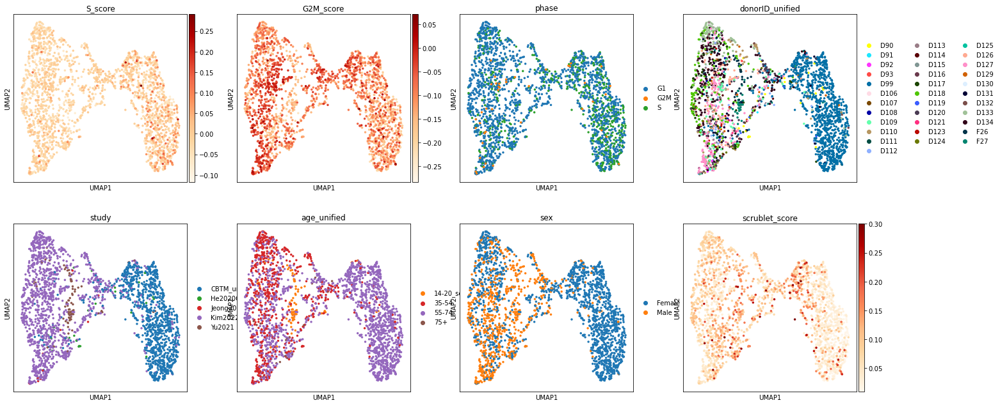

In [152]:
sc.pl.umap(par,color=['S_score','G2M_score','phase','donorID_unified','study','age_unified','sex','scrublet_score'],cmap='OrRd')

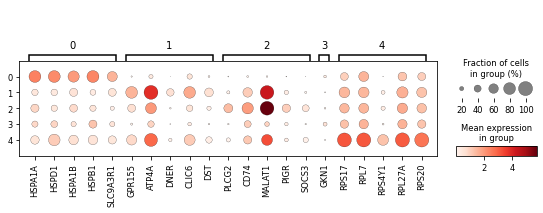

In [153]:
par.raw = par.copy()
mkst = calc_marker_stats(par, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(par, groupby='leiden', mks=mks)

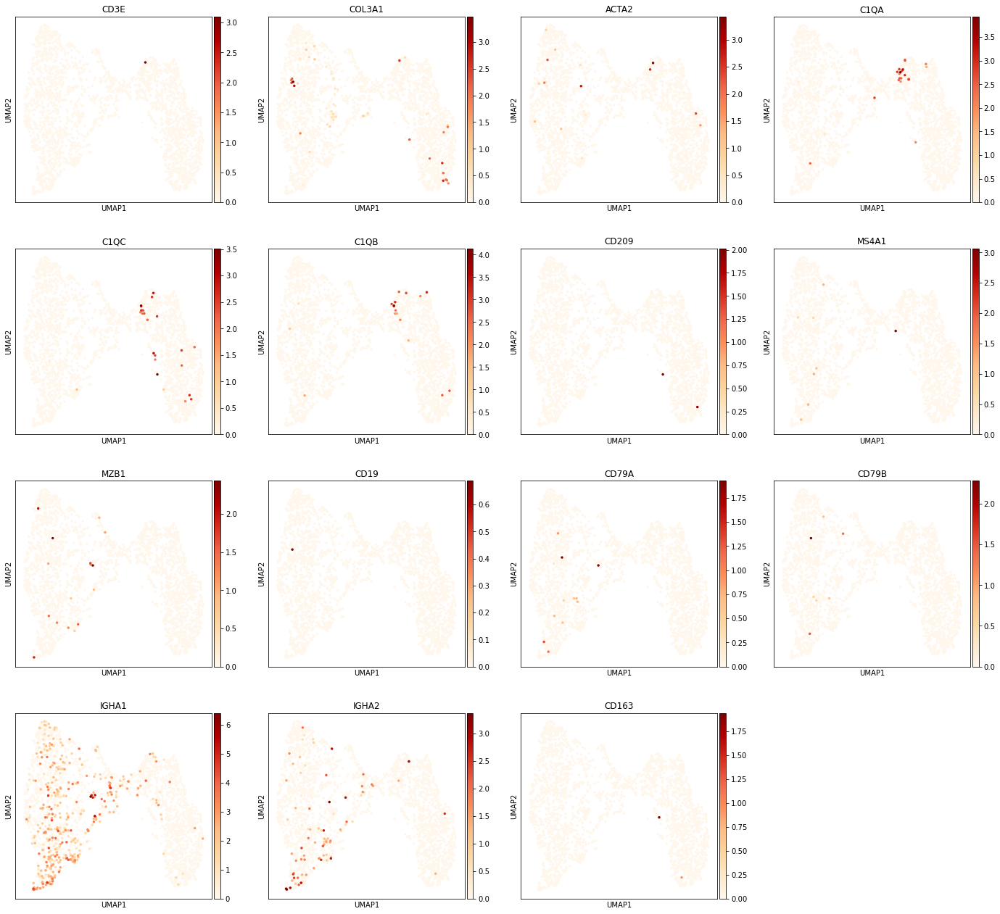

In [156]:
#plot doublet genes
sc.pl.umap(par, color = ['CD3E','COL3A1','ACTA2','C1QA','C1QC','C1QB','CD209','MS4A1','MZB1','CD19','CD79A','CD79B','IGHA1','IGHA2','CD163'],cmap='OrRd')

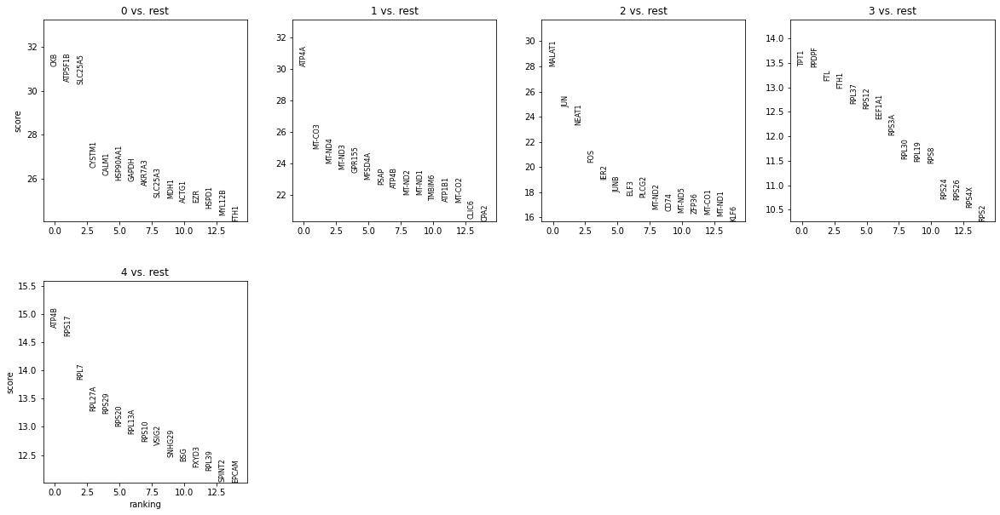

In [157]:
sc.tl.rank_genes_groups(par, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(par, n_genes=15, sharey=False)

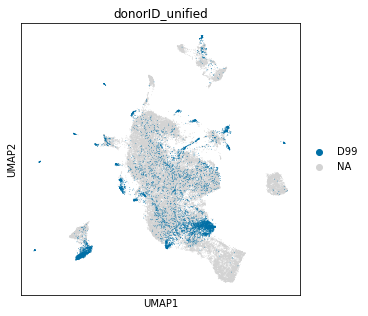

In [158]:
sc.pl.umap(adata,color='donorID_unified',groups='D99')

In [160]:
new_cluster_names = [
    'Gastric_pareital_CBTM','Gastric_pareital', #0,1
    'Gastric_pareital','Gastric_pareital_CBTM',#2,3
    'Gastric_pareital'#4
    
]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

par.obs['annot_v3'] = [conv[x] for x in par.obs['leiden']]

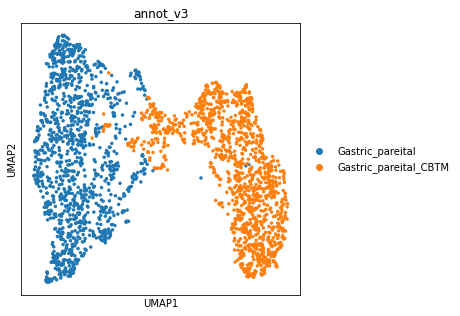

In [162]:
sc.pl.umap(par,color='annot_v3')

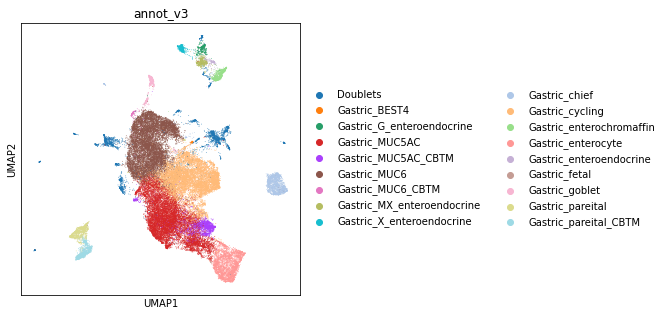

In [166]:
ON = {O:N for O,N in zip(par.obs_names,par.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [167]:
gob = adata[adata.obs.annot_v3.isin(['Gastric_goblet'])].copy()

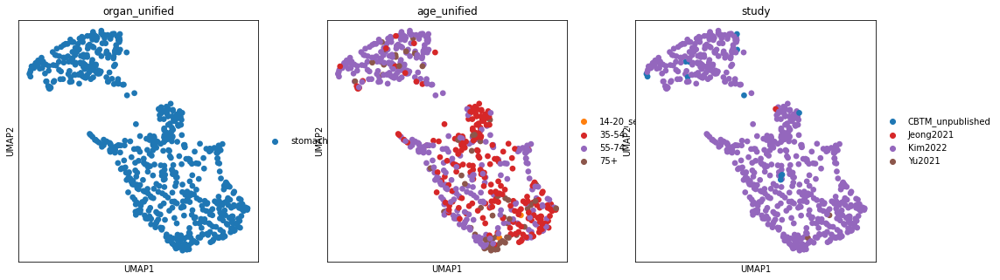

In [168]:
sc.pp.neighbors(
            gob,
            use_rep="X_scvi",
            n_pcs=gob.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(gob, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(gob, color=['organ_unified', 'age_unified','study'])

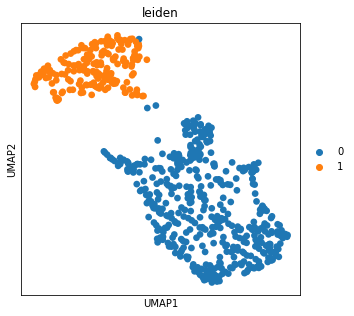

In [171]:
sc.tl.leiden(gob, resolution = 0.2, neighbors_key="neighbors_scvi")
sc.pl.umap(gob, color=['leiden'])

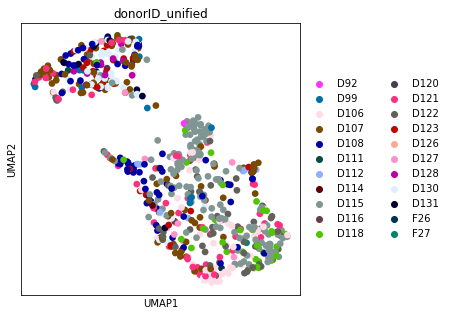

In [189]:
sc.pl.umap(gob, color=['donorID_unified'])

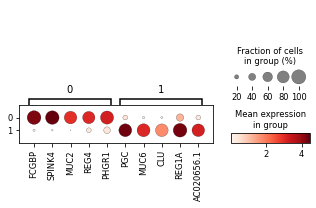

In [172]:
gob.raw = gob.copy()
mkst = calc_marker_stats(gob, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(gob, groupby='leiden', mks=mks)

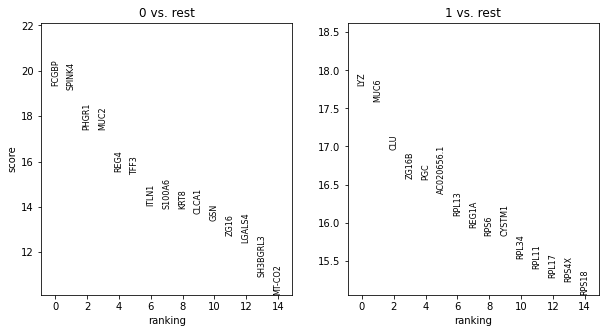

In [184]:
sc.tl.rank_genes_groups(gob, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(gob, n_genes=15, sharey=False)

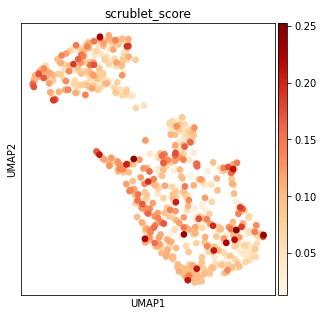

In [174]:
sc.pl.umap(gob,color='scrublet_score',cmap='OrRd')

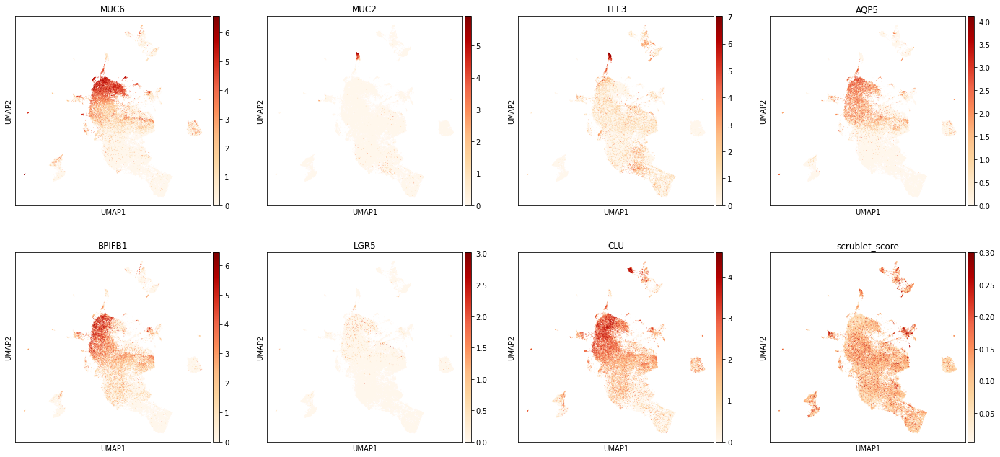

In [183]:
sc.pl.umap(adata,color=['MUC6','MUC2','TFF3','AQP5','BPIFB1','LGR5','CLU','scrublet_score'],cmap='OrRd')

In [185]:
new_cluster_names = [
    'Gastric_goblet','Gastric_MUC6_goblet', #0,1
    
]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

gob.obs['annot_v3'] = [conv[x] for x in gob.obs['leiden']]

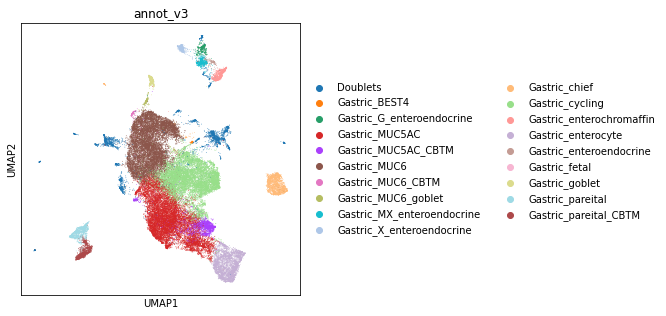

In [186]:
ON = {O:N for O,N in zip(gob.obs_names,gob.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [187]:
gob_m6 = adata[adata.obs.annot_v3.isin(['Gastric_MUC6_goblet','Gastric_MUC6'])].copy()

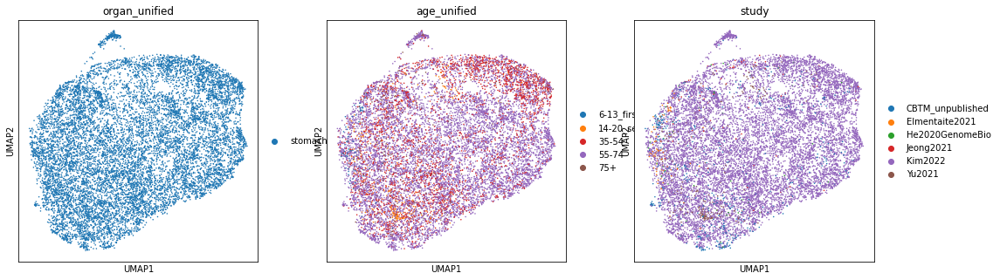

In [188]:
sc.pp.neighbors(
            gob_m6,
            use_rep="X_scvi",
            n_pcs=gob_m6.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(gob_m6, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(gob_m6, color=['organ_unified', 'age_unified','study'])

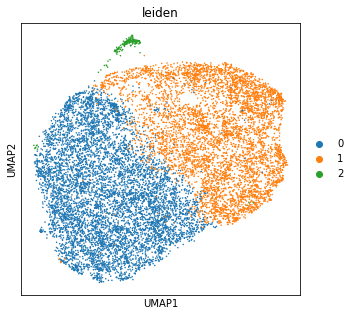

In [190]:
sc.tl.leiden(gob_m6, resolution = 0.2, neighbors_key="neighbors_scvi")
sc.pl.umap(gob_m6, color=['leiden'])

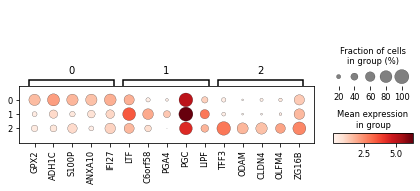

In [191]:
gob_m6.raw = gob_m6.copy()
mkst = calc_marker_stats(gob_m6, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(gob_m6, groupby='leiden', mks=mks)

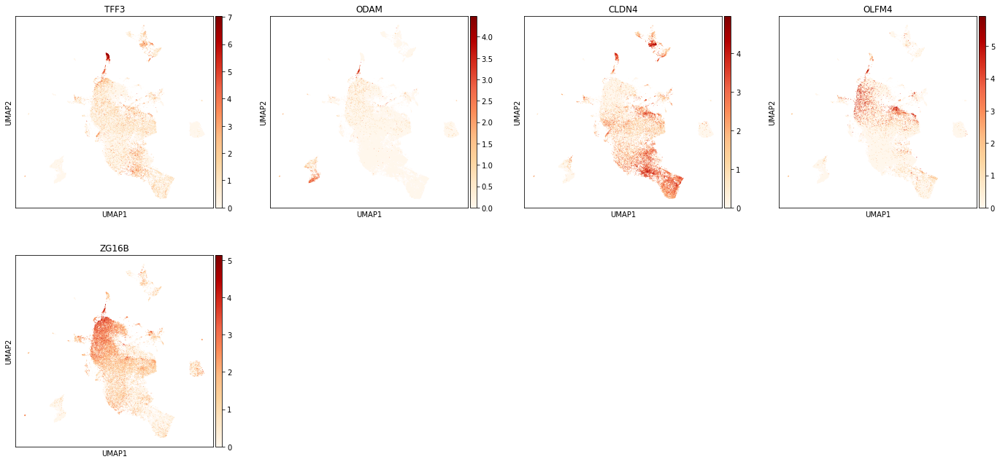

In [193]:
sc.pl.umap(adata,color=['TFF3','ODAM','CLDN4','OLFM4','ZG16B'],cmap='OrRd')

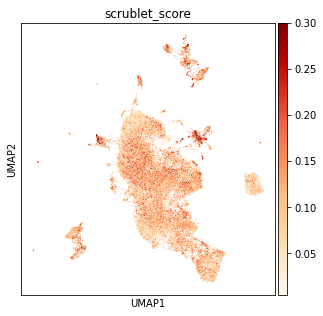

In [194]:
sc.pl.umap(adata,color='scrublet_score',cmap='OrRd')

In [195]:
new_cluster_names = [
    'Gastric_goblet','Gastric_goblet_progenitor_Doublets?', #0,1
    
]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

gob.obs['annot_v3'] = [conv[x] for x in gob.obs['leiden']]

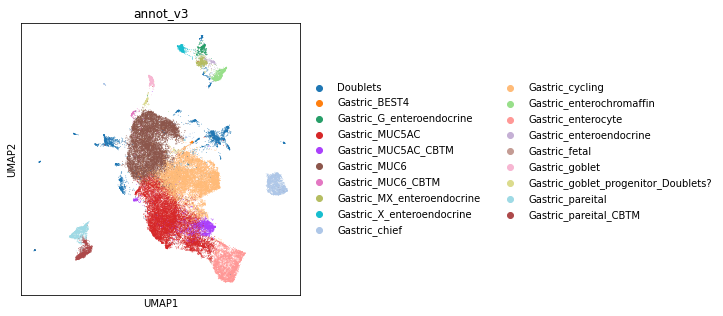

In [196]:
ON = {O:N for O,N in zip(gob.obs_names,gob.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [197]:
ent = adata[adata.obs.annot_v3.isin(['Gastric_enterocyte'])].copy()

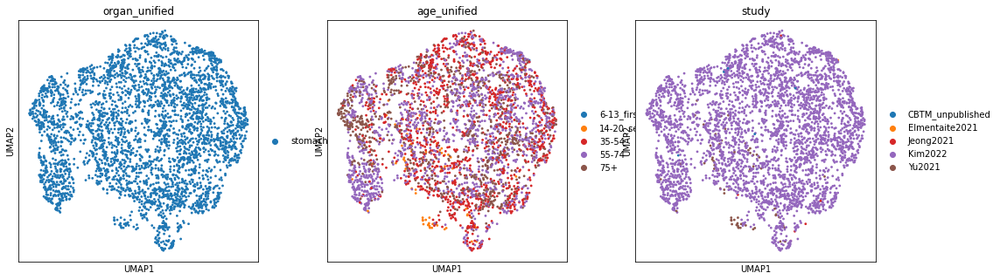

In [198]:
sc.pp.neighbors(
        ent,
            use_rep="X_scvi",
            n_pcs=ent.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(ent, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(ent, color=['organ_unified', 'age_unified','study'])

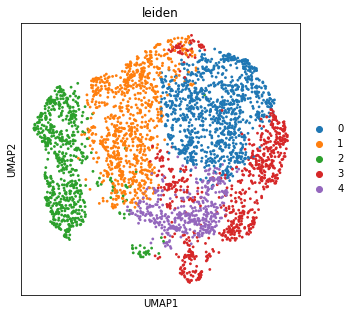

In [206]:
sc.tl.leiden(ent, resolution = 0.4, neighbors_key="neighbors_scvi")
sc.pl.umap(ent, color=['leiden'])

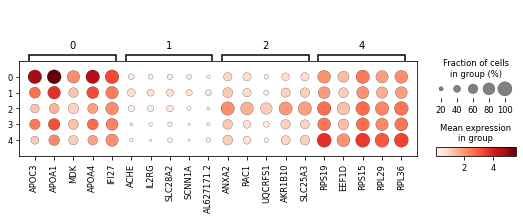

In [202]:
ent.raw = ent.copy()
mkst = calc_marker_stats(ent, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(ent, groupby='leiden', mks=mks)

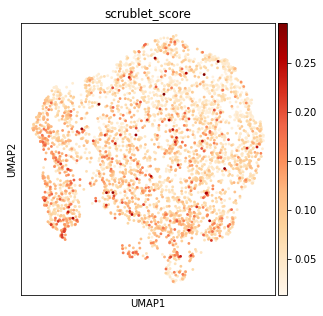

In [204]:
sc.pl.umap(ent,color='scrublet_score',cmap='OrRd')

In [207]:
ent_m5 = adata[adata.obs.annot_v3.isin(['Gastric_enterocyte','Gastric_MUC5AC'])].copy()

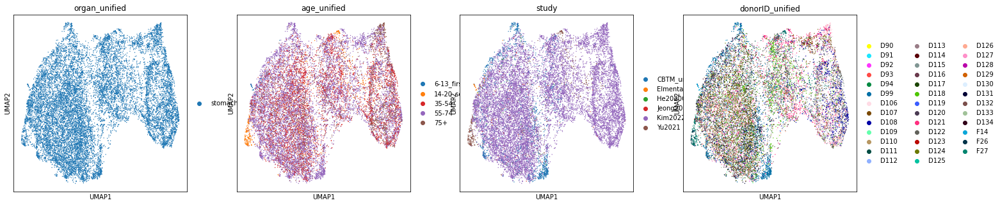

In [209]:
sc.pp.neighbors(
        ent_m5,
            use_rep="X_scvi",
            n_pcs=ent_m5.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(ent_m5, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(ent_m5, color=['organ_unified', 'age_unified','study','donorID_unified'])

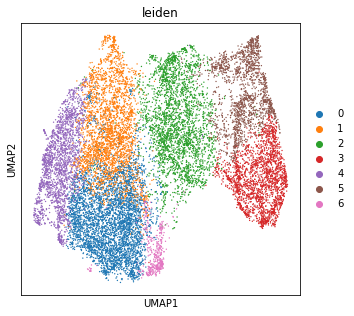

In [215]:
sc.tl.leiden(ent_m5, resolution = 0.5, neighbors_key="neighbors_scvi")
sc.pl.umap(ent_m5, color=['leiden'])

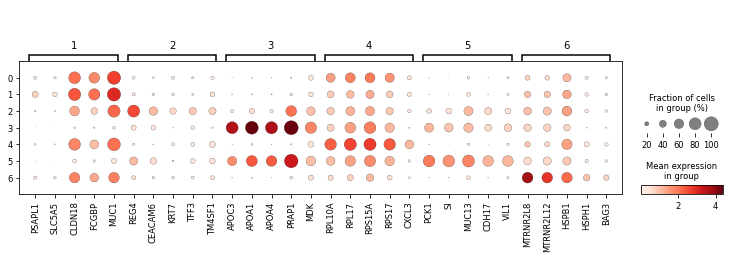

In [216]:
ent_m5.raw = ent_m5.copy()
mkst = calc_marker_stats(ent_m5, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(ent_m5, groupby='leiden', mks=mks)

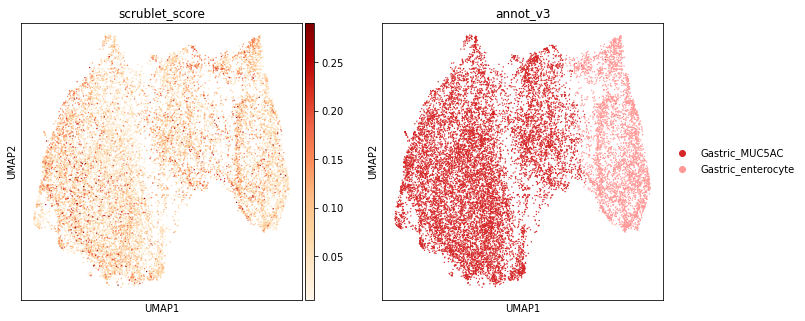

In [218]:
sc.pl.umap(ent_m5,color=['scrublet_score','annot_v3'],cmap='OrRd')

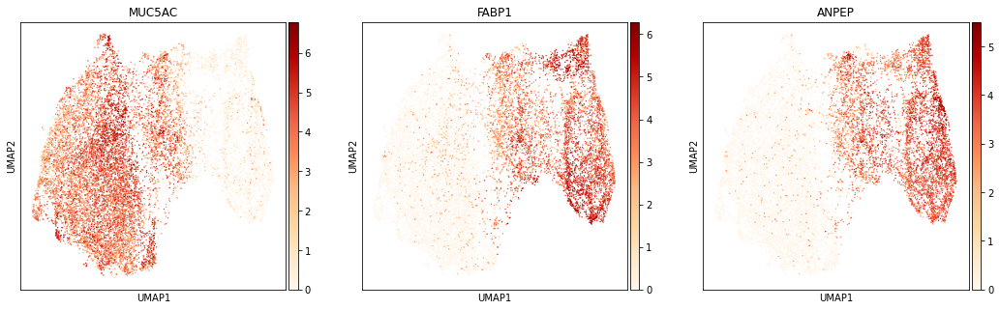

In [220]:
sc.pl.umap(ent_m5,color=['MUC5AC','FABP1','ANPEP'],cmap='OrRd')

In [221]:
new_cluster_names = [
    'Gastric_MUC5AC','Gastric_MUC5AC', #0,1
    'Doublets','Gastric_enterocyte', #2,3
    'Gastric_MUC5AC','Gastric_enterocyte',#4,5
    'Gastric_MUC5AC'
    
]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

ent_m5.obs['annot_v3'] = [conv[x] for x in ent_m5.obs['leiden']]

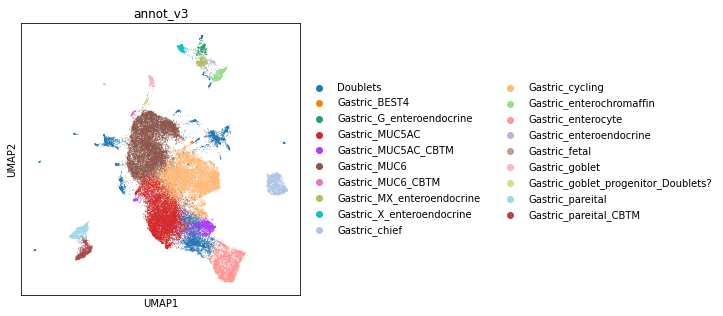

In [222]:
ON = {O:N for O,N in zip(ent_m5.obs_names,ent_m5.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [225]:
list(adata.obs.annot_v3.unique())

['Gastric_pareital_CBTM',
 'Doublets',
 'Gastric_MUC6',
 'Gastric_enterocyte',
 'Gastric_MUC5AC_CBTM',
 'Gastric_MUC5AC',
 'Gastric_enterochromaffin',
 'Gastric_cycling',
 'Gastric_MX_enteroendocrine',
 'Gastric_G_enteroendocrine',
 'Gastric_enteroendocrine',
 'Gastric_pareital',
 'Gastric_X_enteroendocrine',
 'Gastric_goblet_progenitor_Doublets?',
 'Gastric_chief',
 'Gastric_goblet',
 'Gastric_MUC6_CBTM',
 'Gastric_fetal',
 'Gastric_BEST4']

Rename CBTM clusters as doublets to remove

In [226]:
adata.obs['annot_v3'] = (
    adata.obs["annot_v3"]
    .map(lambda x: {'Gastric_pareital_CBTM':'Doublets','Gastric_MUC5AC_CBTM':'Doublets','Gastric_MUC6_CBTM':'Doublets'}.get(x, x))
    .astype("category")
)

In [227]:
list(adata.obs.annot_v3.unique())

['Doublets',
 'Gastric_MUC6',
 'Gastric_enterocyte',
 'Gastric_MUC5AC',
 'Gastric_enterochromaffin',
 'Gastric_cycling',
 'Gastric_MX_enteroendocrine',
 'Gastric_G_enteroendocrine',
 'Gastric_enteroendocrine',
 'Gastric_pareital',
 'Gastric_X_enteroendocrine',
 'Gastric_goblet_progenitor_Doublets?',
 'Gastric_chief',
 'Gastric_goblet',
 'Gastric_fetal',
 'Gastric_BEST4']

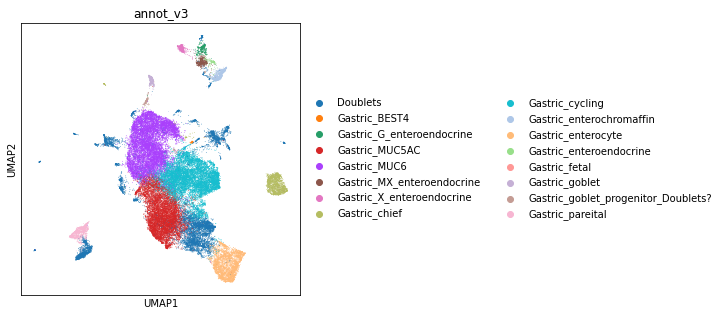

In [228]:
sc.pl.umap(adata,color='annot_v3')

In [229]:
chief = adata[adata.obs.annot_v3.isin(['Gastric_chief'])].copy()

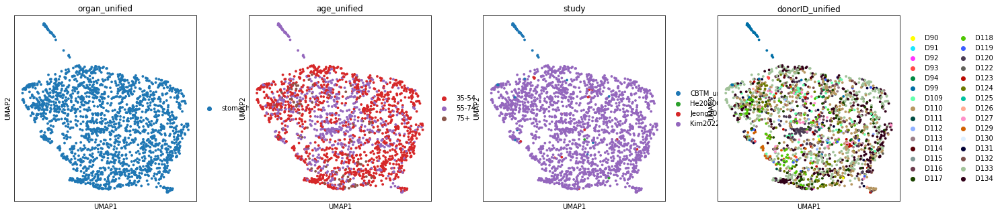

In [230]:
sc.pp.neighbors(
        chief,
            use_rep="X_scvi",
            n_pcs=chief.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(chief, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(chief, color=['organ_unified', 'age_unified','study','donorID_unified'])

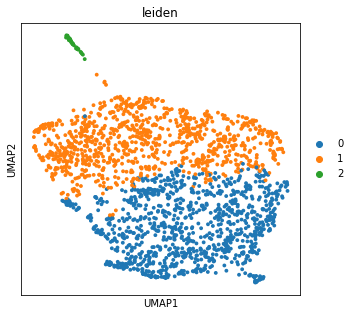

In [232]:
sc.tl.leiden(chief, resolution = 0.2, neighbors_key="neighbors_scvi")
sc.pl.umap(chief, color=['leiden'])

In [233]:
new_cluster_names = [
    'Gastric_chief','Gastric_chief', #0,1
    'Doublets' #2
    
]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

chief.obs['annot_v3'] = [conv[x] for x in chief.obs['leiden']]

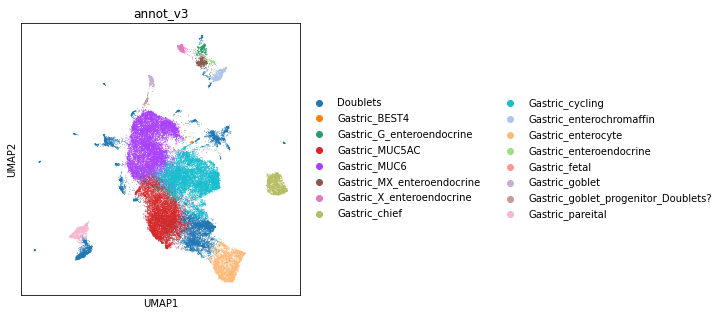

In [234]:
ON = {O:N for O,N in zip(chief.obs_names,chief.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [237]:
adata.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/Stomach_epi.hvg5000_noRPL.scvi_output.annotv3.22021128.h5ad')

In [238]:
annot = adata.obs.loc[:,['annot_v2','annot_v3']]

In [239]:
annot.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/compartment_annotations/csv/Stomach_epi_annot_v3.csv')

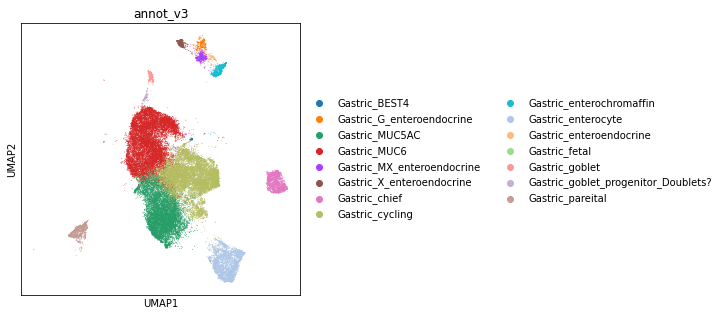

In [240]:
adata_nodoublets = adata[~adata.obs.annot_v3.isin(['Doublets'])].copy()
sc.pl.umap(adata_nodoublets,color='annot_v3')

In [241]:
adata_nodoublets.X.max()

8.9637165

In [242]:
#recover raw
adata_nodoublets.X = adata_nodoublets.layers['counts']

In [243]:
adata_nodoublets.X.max()

20625.0

In [244]:
adata_nodoublets.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/pre_scvi20221124/no_doublets/Stomach_epi.raw.annotv3.nodoublets.22021128.h5ad')

Double check doublet clusters

In [249]:
doub = adata[adata.obs.annot_v3.isin(['Doublets'])].copy()

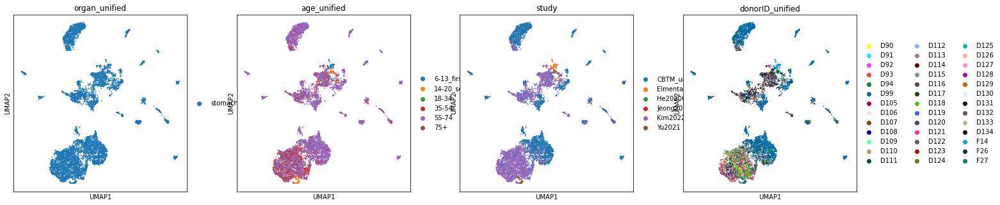

In [250]:
sc.pp.neighbors(
        doub,
            use_rep="X_scvi",
            n_pcs=doub.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(doub, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(doub, color=['organ_unified', 'age_unified','study','donorID_unified'])

In [251]:
doub.obs['leiden_all'] = doub.obs.leiden

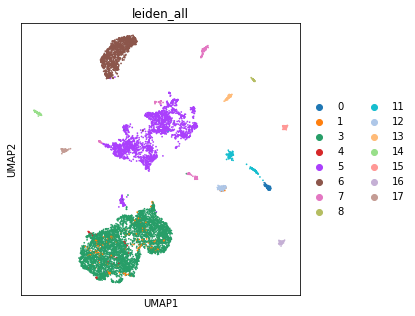

In [252]:
sc.pl.umap(doub, color=['leiden_all'])

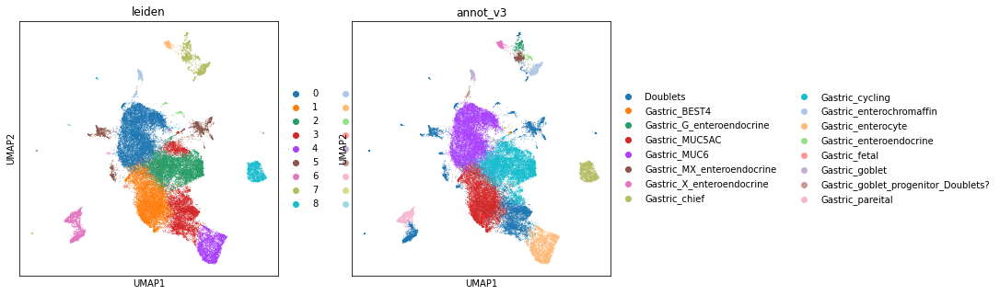

In [254]:
sc.pl.umap(adata,color=['leiden','annot_v3'])

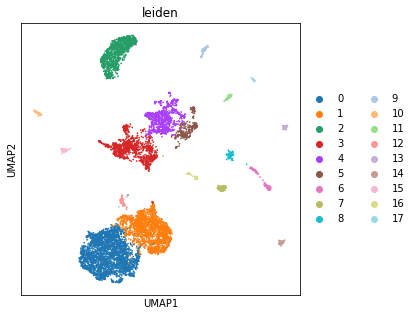

In [253]:
sc.tl.leiden(doub, resolution = 0.5, neighbors_key="neighbors_scvi")
sc.pl.umap(doub, color=['leiden'])

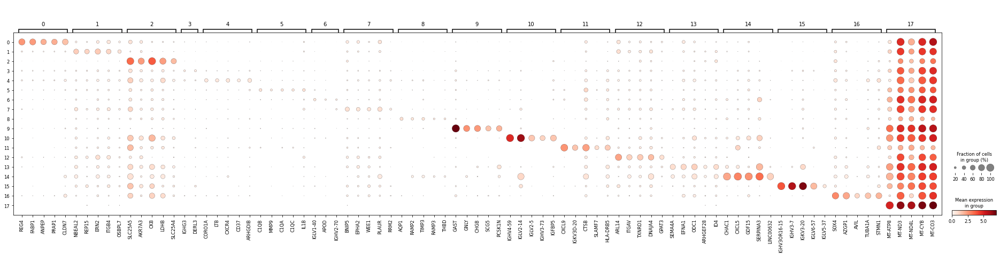

In [248]:
doub.raw = doub.copy()
mkst = calc_marker_stats(doub, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(doub, groupby='leiden', mks=mks)

In [3]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/Stomach_epi.hvg5000_noRPL.scvi_output.annotv3.22021128.h5ad')

In [3]:
list(adata.obs.annot_v3.unique())

['Doublets',
 'Gastric_MUC6',
 'Gastric_enterocyte',
 'Gastric_MUC5AC',
 'Gastric_enterochromaffin',
 'Gastric_cycling',
 'Gastric_MX_enteroendocrine',
 'Gastric_G_enteroendocrine',
 'Gastric_enteroendocrine',
 'Gastric_pareital',
 'Gastric_X_enteroendocrine',
 'Gastric_goblet_progenitor_Doublets?',
 'Gastric_chief',
 'Gastric_goblet',
 'Gastric_fetal',
 'Gastric_BEST4']

In [8]:
adata.uns['log1p']["base"] = None

In [9]:
gob = adata[adata.obs.annot_v3.isin(['Gastric_goblet','Gastric_goblet_progenitor_Doublets?','Gastric_MUC6'])].copy()

In [10]:
gob

AnnData object with n_obs × n_vars = 13268 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

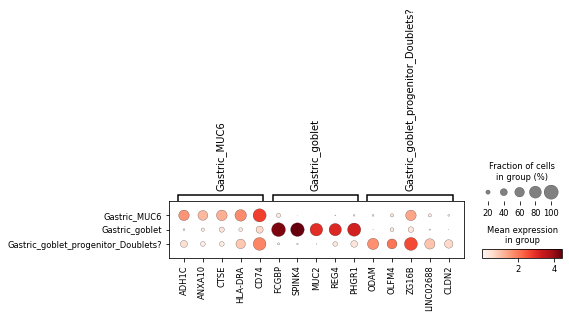

In [7]:
gob.raw = gob.copy()
mkst = calc_marker_stats(gob, groupby="annot_v3")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(gob, groupby='annot_v3', mks=mks)

categories: 0, 9
var_group_labels: Gastric_MUC6, Gastric_goblet, Gastric_goblet_progenitor_Doublets?


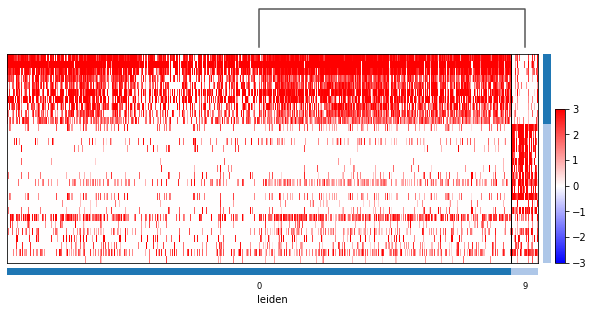

In [12]:
sc.tl.rank_genes_groups(gob,groupby='annot_v3',method='wilcoxon')
sc.tl.dendrogram(gob, groupby='annot_v3')


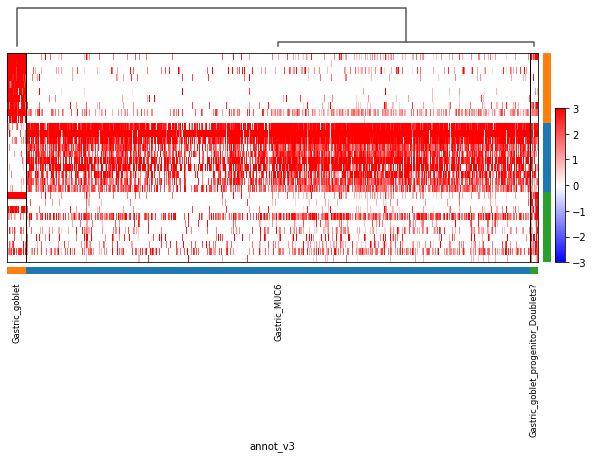

In [13]:
sc.pl.rank_genes_groups_heatmap(gob,groupby='annot_v3', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=False,
                                vmin=-3, vmax=3, cmap='bwr')

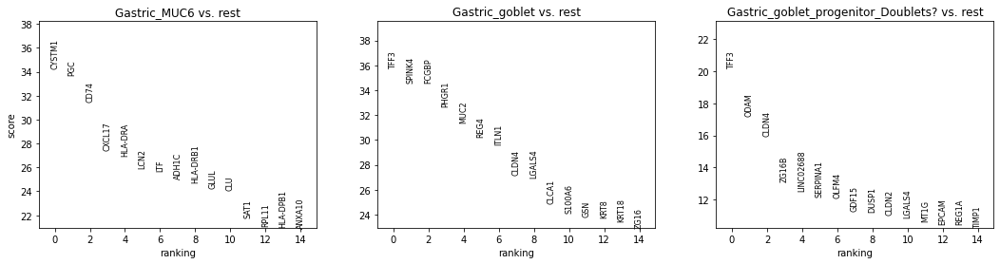

In [14]:
sc.tl.rank_genes_groups(gob, 'annot_v3', method='wilcoxon')
sc.pl.rank_genes_groups(gob, n_genes=15, sharey=False)

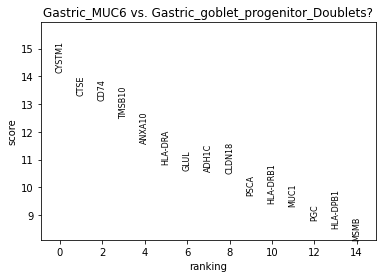

In [15]:
sc.tl.rank_genes_groups(gob, 'annot_v3', method='wilcoxon',groups=['Gastric_MUC6'],reference='Gastric_goblet_progenitor_Doublets?')
sc.pl.rank_genes_groups(gob, n_genes=15, sharey=False,groups=['Gastric_MUC6'])

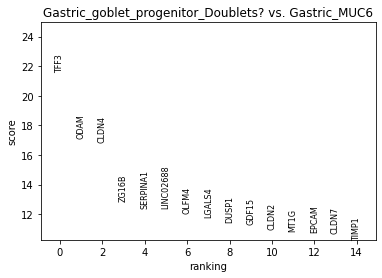

In [16]:
sc.tl.rank_genes_groups(gob, 'annot_v3', method='wilcoxon',groups=['Gastric_goblet_progenitor_Doublets?'],reference='Gastric_MUC6')
sc.pl.rank_genes_groups(gob, n_genes=15, sharey=False,groups=['Gastric_goblet_progenitor_Doublets?'])

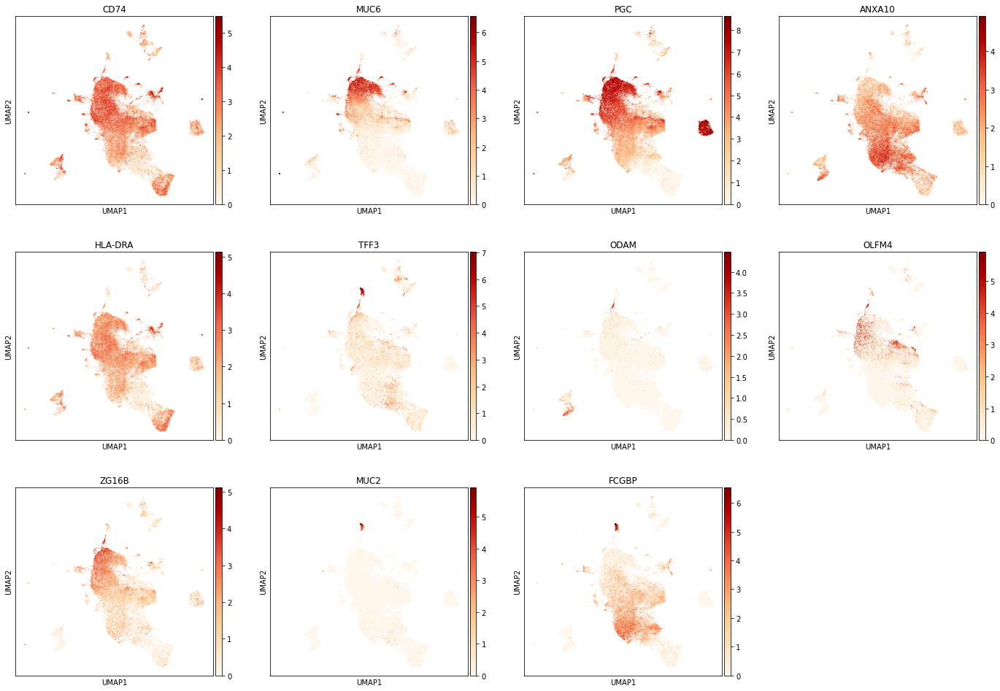

In [18]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata,color=['CD74','MUC6','PGC','ANXA10','HLA-DRA','TFF3','ODAM','OLFM4','ZG16B','MUC2','FCGBP'],cmap='OrRd')

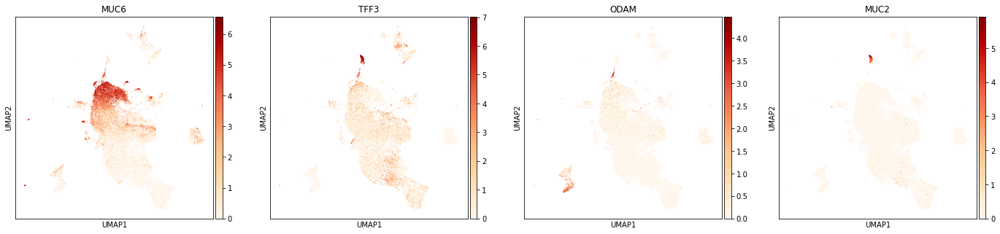

In [20]:
sc.pl.umap(adata,color=['MUC6','TFF3','ODAM','MUC2'],cmap='OrRd')

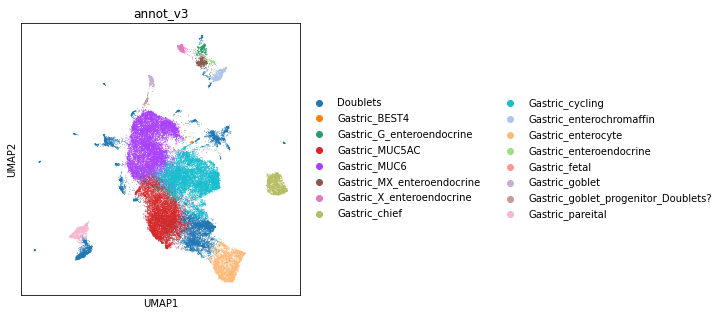

In [22]:
sc.pl.umap(adata,color=['annot_v3'])

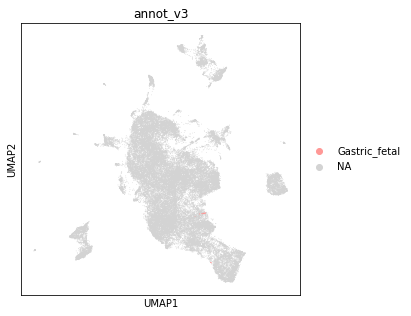

In [23]:
sc.pl.umap(adata,color=['annot_v3'],groups='Gastric_fetal')

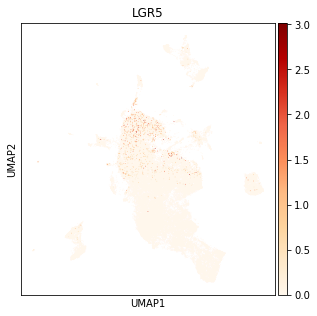

In [25]:
sc.pl.umap(adata,color='LGR5',cmap='OrRd')

In [26]:
adata.obs['annot_v3'] = (
    adata.obs["annot_v3"]
    .map(lambda x: {'Gastric_goblet_progenitor_Doublets?':'Gastric_goblet_progenitor'}.get(x, x))
    .astype("category")
)

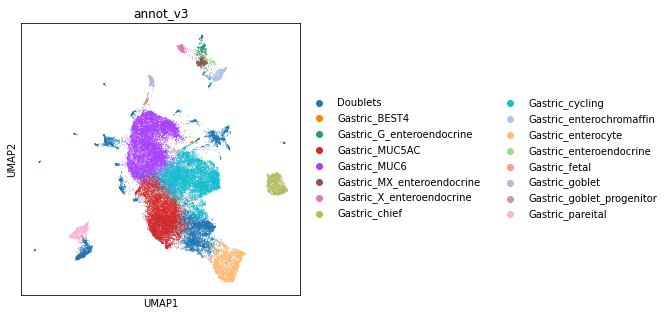

In [27]:
sc.pl.umap(adata,color='annot_v3')

In [28]:
adata.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/Stomach_epi.hvg5000_noRPL.scvi_output.annotv3.22021201.h5ad')

In [29]:
annot = adata.obs.loc[:,['annot_v2','annot_v3']]

In [30]:
annot.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/compartment_annotations/csv/Stomach_epi_annot_v3.csv')

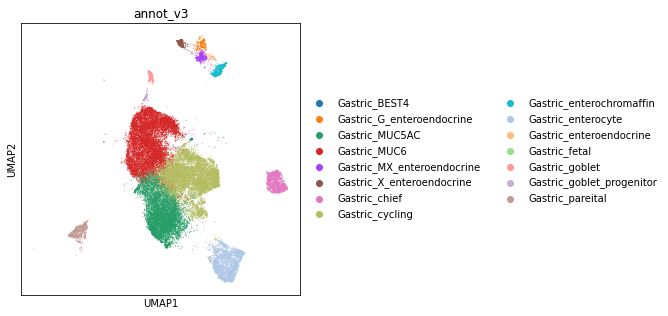

In [31]:
adata_nodoublets = adata[~adata.obs.annot_v3.isin(['Doublets'])].copy()
sc.pl.umap(adata_nodoublets,color='annot_v3')

In [32]:
#recover raw
adata_nodoublets.X = adata_nodoublets.layers['counts']

In [33]:
adata_nodoublets.X.max()

20625.0

In [34]:
adata_nodoublets.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/pre_scvi20221124/no_doublets/Stomach_epi.raw.annotv3.nodoublets.22021201.h5ad')

In [2]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/Stomach_epi.hvg5000_noRPL.scvi_output.annotv3.22021201.h5ad')

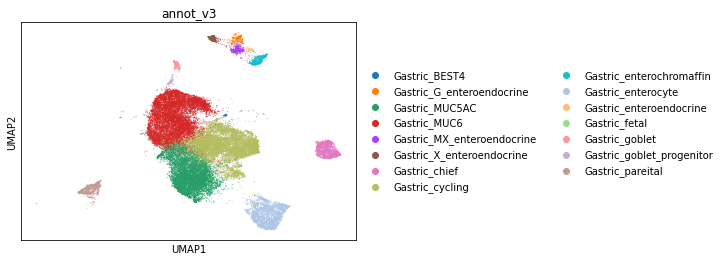

In [3]:
adata = adata[~adata.obs.annot_v3.isin(['Doublets'])].copy()
sc.pl.umap(adata,color='annot_v3')

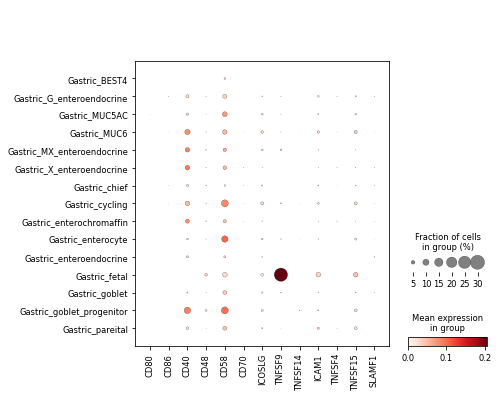

In [5]:
#co-stimulatory
sc.pl.dotplot(adata, ["CD80", "CD86", "CD40", "CD48", "CD58", "CD70", "ICOSLG", "TNFSF9",
                       "TNFSF14", "ICAM1",  "TNFSF4", "TNFSF15", "SLAMF1"
], groupby="annot_v3")

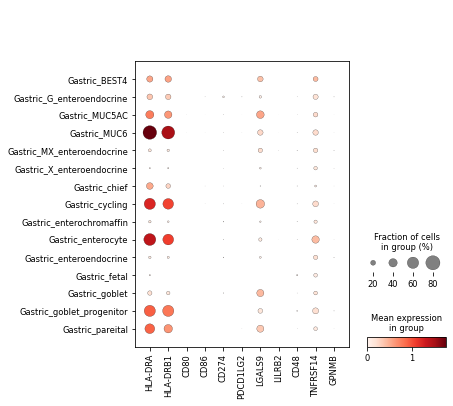

In [7]:
#co-inhibitory
sc.pl.dotplot(adata, ["HLA-DRA", "HLA-DRB1", 
    "CD80", "CD86",
                    "CD274", "PDCD1LG2", "LGALS9",  "LILRB2", "CD48",
                       "TNFRSF14", "GPNMB"
], groupby="annot_v3")

## Plot for figures

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/no_doublets/Stomach_epi.hvg5000_noRPL.scvi_output.annotv3.nodoublets.22021208.h5ad')

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


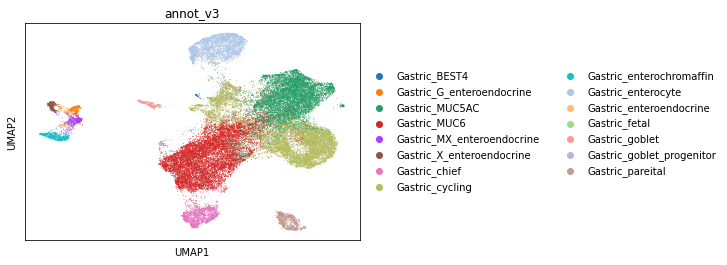

In [3]:
sc.pl.umap(adata,color='annot_v3')

In [4]:
list(adata.obs.annot_v3.unique())

['Gastric_MUC6',
 'Gastric_enterocyte',
 'Gastric_MUC5AC',
 'Gastric_enterochromaffin',
 'Gastric_cycling',
 'Gastric_MX_enteroendocrine',
 'Gastric_G_enteroendocrine',
 'Gastric_enteroendocrine',
 'Gastric_pareital',
 'Gastric_X_enteroendocrine',
 'Gastric_goblet_progenitor',
 'Gastric_chief',
 'Gastric_goblet',
 'Gastric_fetal',
 'Gastric_BEST4']

In [5]:
adata.obs['fine_annot'] = adata.obs["annot_v3"].str.replace("Gastric_","")

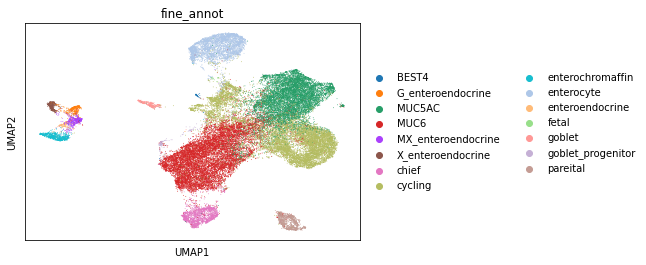

In [6]:
sc.pl.umap(adata,color='fine_annot')

In [7]:
list(adata.obs.fine_annot.unique())

['MUC6',
 'enterocyte',
 'MUC5AC',
 'enterochromaffin',
 'cycling',
 'MX_enteroendocrine',
 'G_enteroendocrine',
 'enteroendocrine',
 'pareital',
 'X_enteroendocrine',
 'goblet_progenitor',
 'chief',
 'goblet',
 'fetal',
 'BEST4']

In [8]:
adata.obs['fine_annot'] = (
    adata.obs["fine_annot"]
    .map(lambda x: {
 'enterocyte':'Enterocyte',
 'enterochromaffin':'Enterochromaffin',
 'cycling':'Cycling',
 'enteroendocrine':'Enteroendocrine',
 'pareital':'Pareital',
 #'X_enteroendocrine':'Enteroendocrine', --> accidentally merged X_enteroendocrine with enteroendocrine in previous iteration
 'goblet_progenitor':'Goblet_progenitor',
 'chief':'Chief',
 'goblet':'Goblet',
 'fetal':'Fetal',
        
         }.get(x, x))
    .astype("category")
)

In [9]:
list(adata.obs.fine_annot.unique())

['MUC6',
 'Enterocyte',
 'MUC5AC',
 'Enterochromaffin',
 'Cycling',
 'MX_enteroendocrine',
 'G_enteroendocrine',
 'Enteroendocrine',
 'Pareital',
 'X_enteroendocrine',
 'Goblet_progenitor',
 'Chief',
 'Goblet',
 'Fetal',
 'BEST4']

In [10]:
adata.obs.fine_annot.cat.categories

Index(['BEST4', 'G_enteroendocrine', 'MUC5AC', 'MUC6', 'MX_enteroendocrine',
       'X_enteroendocrine', 'Chief', 'Cycling', 'Enterochromaffin',
       'Enterocyte', 'Enteroendocrine', 'Fetal', 'Goblet', 'Goblet_progenitor',
       'Pareital'],
      dtype='object')

In [11]:
adata.obs['fine_annot'] = (
    adata.obs["fine_annot"]
    .map(lambda x: {
        'MUC6':'Mucous_gland_neck',
        'MUC5AC':'Surface_foveolar'
        
         }.get(x, x))
    .astype("category")
)

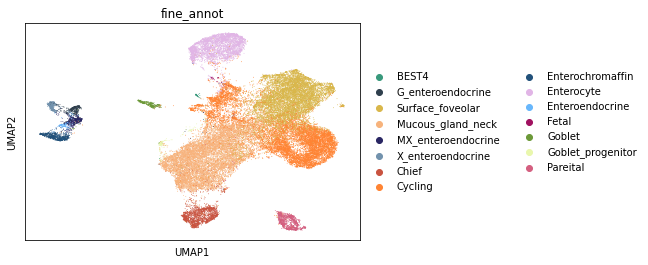

In [12]:
sc.pl.umap(adata,color='fine_annot',palette = ['#39997c',#BEST4
                                                 '#2f3f4d',#G_enteroendocrine
                                               '#d9b74a',#MUC5AC/surface foveolar
                                               '#f7b37c',#MUC6/mucous gland neck
                                               '#292663',#MX enteroendocrine
                                                 '#7292ad',#X_enteroendocrine
                                               
                                               '#c95340',#chief
                                               '#ff8433',#'Cycling',
                                               '#22517a',#enterochromaffin
                                               '#e1b5e6',#enterocyte
                                               '#68b7fc',#enteroendocrine
                                               '#a01160',#Fetal
                                             
                                               '#6c9939',#goblet
                                               '#e9f7ad',#goblet progenitor
                                               
                                               
                                               '#d45f80',#pareital
                                             
                                               
                                               
    
    
                                              ])

In [13]:
#save raw counts in layers
adata.layers['counts'] = adata.X
#normalise and transform
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)

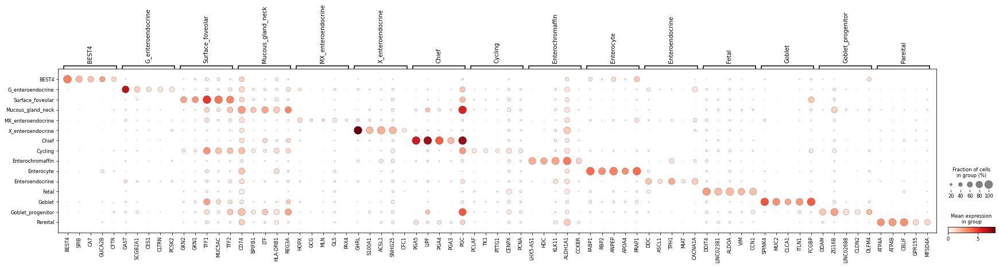

In [14]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="fine_annot")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='fine_annot', mks=mks)

In [15]:
# make some plots for figure

In [16]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
plt.rcParams['figure.figsize'] = [5,5]
sc.set_figure_params(dpi=300,dpi_save=600)

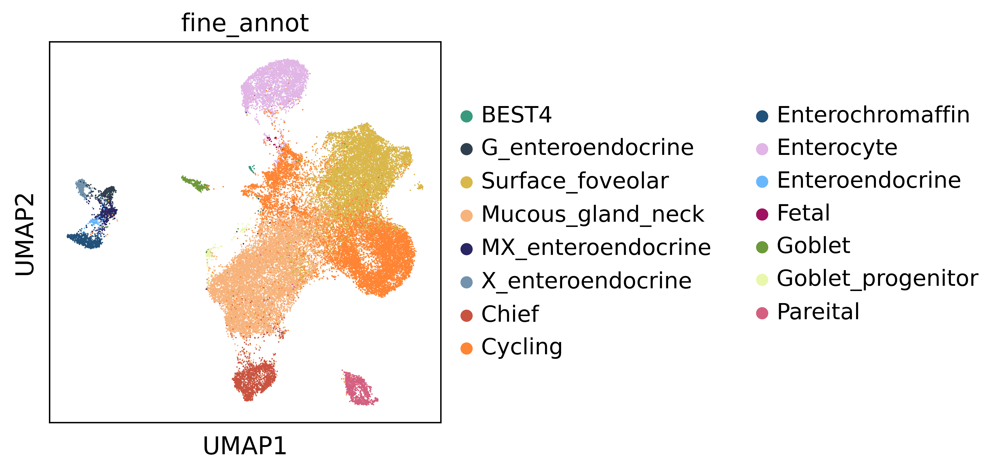

In [17]:
sc.pl.umap(adata,color='fine_annot',save='stomach_epi_annot.png')

<AxesSubplot: title={'center': 'fine_annot'}, xlabel='UMAP1', ylabel='UMAP2'>

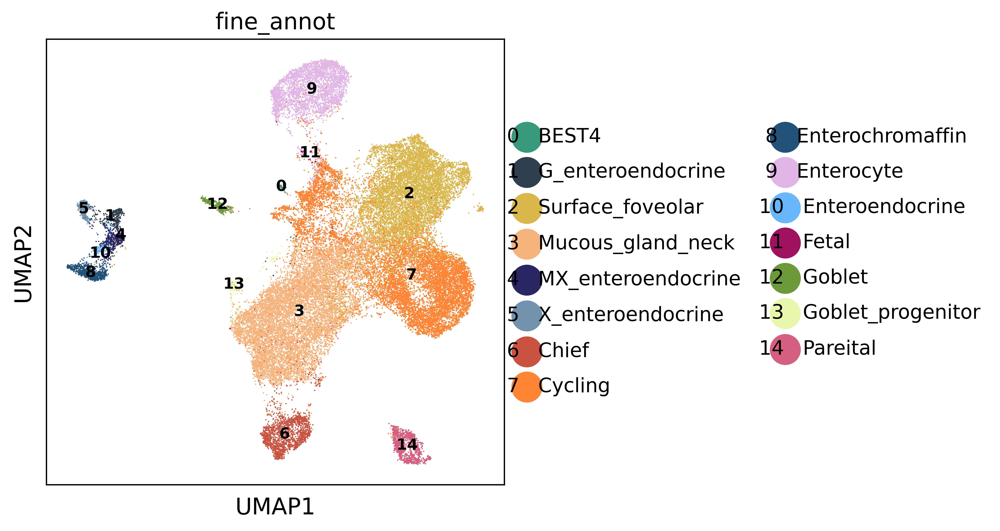

In [18]:
import sctk as sk
sk.plot_embedding(
    adata,
    basis="umap",
    groupby="fine_annot",
    figsize=(5, 5),
    save='figures/stomach_epi_annot.png')

In [19]:
marker_genes_dict = { 'Chief':['PGA5','LIPF','PGA3','PGC','CHIA'],
                     'Pareital':['ATP4A','ATP4B','CBLIF','GPR155','MFSD4A'],
                      'Surface Foveolar':['MUC5AC','GKN1','GKN2'],
                     'Mucous Gland Neck':['MUC6','AQP5','BPIFB1'],
    'BEST4':['BEST4','SPIB','CA7','GUCA2B','CFTR'],
                     'Enterocyte':['FABP1','ENPEP','APOA4','PRAP1'],                    
                     'Cycling':['MKI67','PCLAF','PCNA'],
                     'Fetal':['DDIT4','ALDOA','VIM','CCN1'],
                     'Enteroendocrine':['CHGA','DDC','TPH1','CACNA1A'],
                     'G_enteroendocrine':['GAST','SCGB2A1','CLTRN','CES1','PAX6'],
                     'MX_enteroendocrine':['HOPX','CRYBA2','GCG','MLN','GLS'],
                     'X_enteroendocrine':['GHRL','GC','ACSL1','S100A1'],
                     'Enterochromaffin':['HDC','MAOB','LHX5-AS1','KLK11','CHGA'],
                     'Goblet':['MUC2','TFF3','SPINK4','FCGBP'],
                     'Goblet_progenitor':['ODAM','OLFM4']
                     
                     
}

In [20]:
list(adata.obs.annot_v3.unique())

['Gastric_MUC6',
 'Gastric_enterocyte',
 'Gastric_MUC5AC',
 'Gastric_enterochromaffin',
 'Gastric_cycling',
 'Gastric_MX_enteroendocrine',
 'Gastric_G_enteroendocrine',
 'Gastric_enteroendocrine',
 'Gastric_pareital',
 'Gastric_X_enteroendocrine',
 'Gastric_goblet_progenitor',
 'Gastric_chief',
 'Gastric_goblet',
 'Gastric_fetal',
 'Gastric_BEST4']

In [21]:
adata.obs['annot_v3'].cat.reorder_categories([ 
    
    'Gastric_chief',
     'Gastric_pareital',
    'Gastric_MUC5AC',
    'Gastric_MUC6',
     'Gastric_BEST4',
 'Gastric_enterocyte',
    'Gastric_cycling',
     'Gastric_fetal',
     'Gastric_enteroendocrine',
     'Gastric_G_enteroendocrine',
     'Gastric_MX_enteroendocrine',
    'Gastric_X_enteroendocrine',
 'Gastric_enterochromaffin',
 'Gastric_goblet',
 'Gastric_goblet_progenitor'
       ], inplace=True)


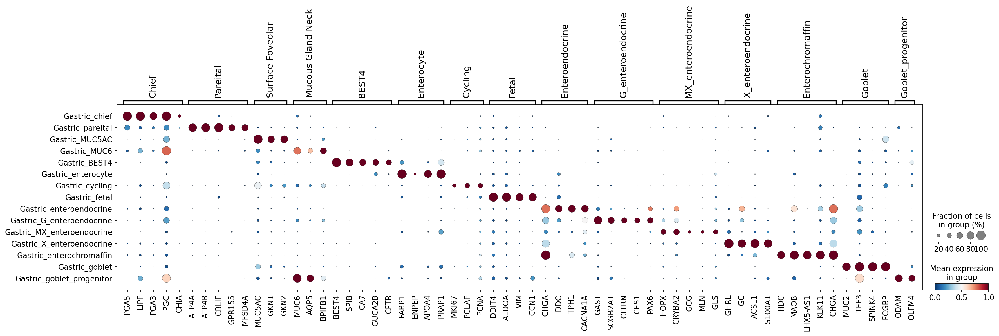

In [22]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
sc.set_figure_params(dpi_save = 300)
sc.pl.dotplot(adata,var_names=marker_genes_dict,groupby='annot_v3',save='Epi_stomach_markers.pdf',color_map='RdBu_r', standard_scale='var')

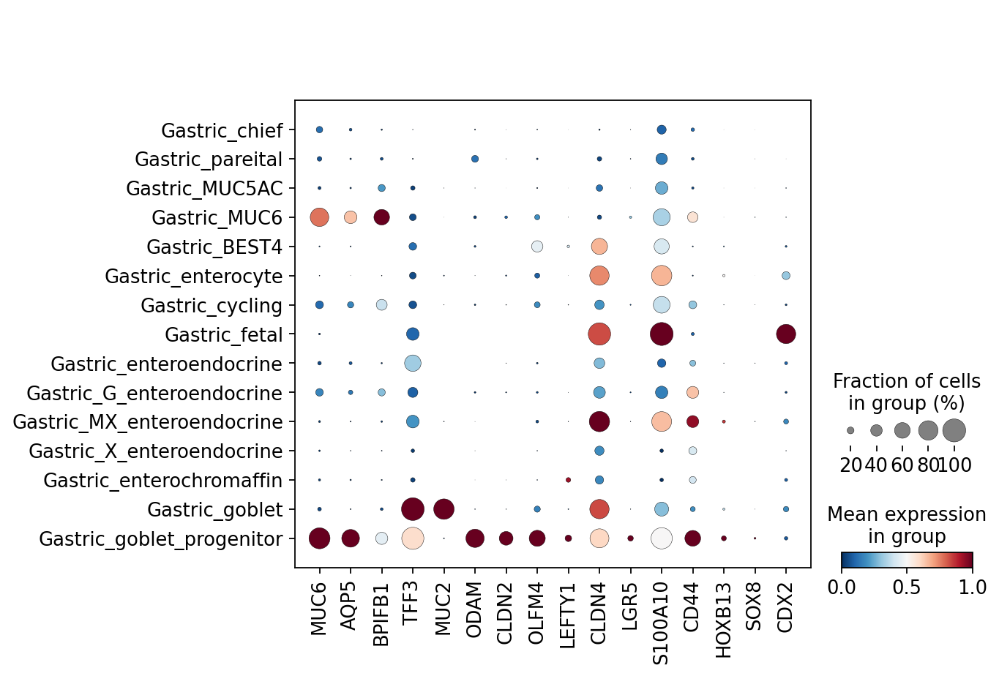

In [23]:
#plot markers of "linking cells" from this paper: https://www.biorxiv.org/content/10.1101/2022.05.22.493006v2.full.pdf
sc.pl.dotplot(adata,var_names=['MUC6','AQP5','BPIFB1','TFF3','MUC2','ODAM','CLDN2','OLFM4','LEFTY1','CLDN4','LGR5','S100A10','CD44','HOXB13','SOX8','CDX2'],groupby='annot_v3',color_map='RdBu_r', standard_scale='var')